# Visualisation tool for a 2D function approximated using BO
the BayesianOptimization repo had a visualisation tool for a 2D function. But it is [no longuer maintained](https://github.com/fmfn/BayesianOptimization/issues/18). We decided to fix the old code for debugging purpose. Only the Acquisition Function was not fixed. you will probably not use it :)

A shorter and a better code was used for the "BO with a afterward Boosting Network" model (TODO: add link)

In [351]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [352]:
def unique_rows(a):
    """
    A functions to trim repeated rows that may appear when optimizing.
    This is necessary to avoid the sklearn GP object from breaking

    :param a: array to trim repeated rows from

    :return: mask of unique rows
    """

    # Sort array and kep track of where things should go back to
    order = np.lexsort(a.T)
    reorder = np.argsort(order)

    a = a[order]
    diff = np.diff(a, axis=0)
    ui = np.ones(len(a), 'bool')
    ui[1:] = (diff != 0).any(axis=1)

    return ui[reorder]



def target(x, y):
    a = np.exp(-( (x - 2)**2/0.7 + (y - 4)**2/1.2) + (x - 2)*(y - 4)/1.6 )
    b = np.exp(-( (x - 4)**2/3 + (y - 2)**2/2.) )
    c = np.exp(-( (x - 4)**2/0.5 + (y - 4)**2/0.5) + (x - 4)*(y - 4)/0.5 )
    d = np.sin(3.1415 * x)
    e = np.exp(-( (x - 5.5)**2/0.5 + (y - 5.5)**2/.5) )
    return 2*a + b - c + 0.17 * d + 2*e


In [353]:

n = 1e5
x = y = np.linspace(0, 6, 300)
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]
z = target(x, y)



print(max(z))
print(min(z))
X

2.0642339183485188
-0.8868161382258206


array([[0.        , 0.        ],
       [0.        , 0.02006689],
       [0.        , 0.04013378],
       ...,
       [6.        , 5.95986622],
       [6.        , 5.97993311],
       [6.        , 6.        ]])

## 2D Function to approximate

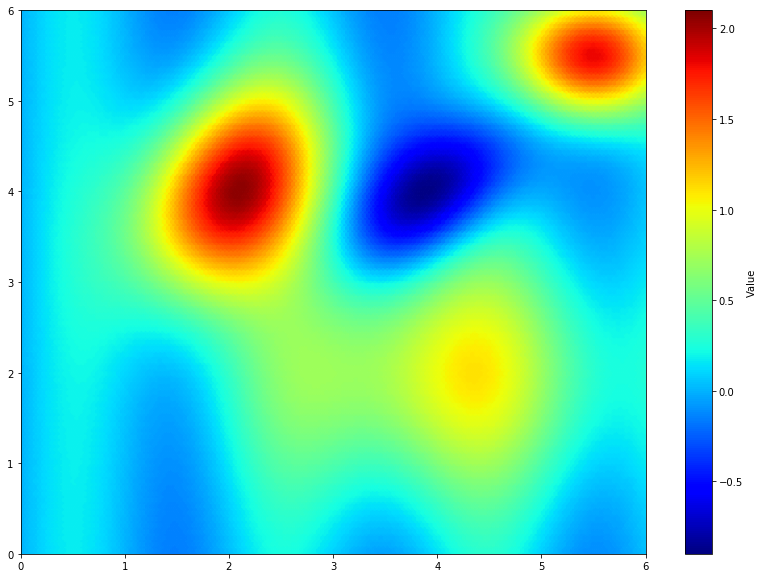

In [354]:

fig, axis = plt.subplots(1, 1, figsize=(14, 10))
gridsize=150

im = axis.hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-0.9, vmax=2.1)
axis.axis([x.min(), x.max(), y.min(), y.max()])

cb = fig.colorbar(im, )
cb.set_label('Value')


In [355]:

def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    #print("x_obs",x_obs)
    #print("y_obs",y_obs)
    
    bo._gp.fit(x_obs, y_obs)
    #print(bo._gp)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    #mu, sigma2 = bo._gp.predict(X[:2,:])
    #print("X[:2,:]",X[:2,:])
    #print("x_obs",x_obs)
    #mu, sigma2 = bo._gp.predict(x_obs)
    #print("mu",mu)
    #print("sigma2",sigma2)
    ##mu, sigma2 = bo._gp.predict(X) # eval_MSE=True
    
    #uf = UtilityFunction(kind='ucb', kappa=10, xi=1.0) # xi=1.0 zetha ena w 3andha 7ata ma3na
    
    #print("sqrt",np.sqrt(sigma2))
    
    #return mu, np.sqrt(sigma2), uf.utility(X, bo._gp, y_obs.max())
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean', fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-0.9, vmax=2.1)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][0].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k', label='Observations')
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-0.9, vmax=2.1)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')


    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
"""
    for im, axis in zip([im00, im10, im01], ax.flatten()):#, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)



In [356]:

bo = BayesianOptimization(target, {'x': (0, 6), 'y': (0, 6)})

used_kappa = 10

#gp_params = {'corr': 'absolute_exponential', 'nugget': 1e-9}
bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa, )



|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  1        | -0.1189   |  1.338    |  0.4741   |
|  2        |  0.1428   |  0.3078   |  0.3758   |
|  3        | -0.1344   |  1.353    |  0.1584   |
|  4        |  0.3448   |  3.001    |  3.162    |
|  5        |  1.496    |  2.535    |  3.883    |


In [357]:
x_obs = np.array([[res["params"]["x"]] for res in bo.res])
x_obs

array([[1.33821466],
       [0.30779825],
       [1.35303595],
       [3.00060334],
       [2.53546679]])

In [358]:
np.array([[res["params"]] for res in bo.res])

array([[{'x': 1.3382146632323129, 'y': 0.47408382917835934}],
       [{'x': 0.3077982539247037, 'y': 0.3758313010290486}],
       [{'x': 1.3530359532715734, 'y': 0.15840522447826721}],
       [{'x': 3.000603340258587, 'y': 3.161549974821943}],
       [{'x': 2.535466793317445, 'y': 3.8831547248021803}]], dtype=object)

In [359]:
bo.res

[{'target': -0.11892951811288022,
  'params': {'x': 1.3382146632323129, 'y': 0.47408382917835934}},
 {'target': 0.14280637425627835,
  'params': {'x': 0.3077982539247037, 'y': 0.3758313010290486}},
 {'target': -0.13441424905517288,
  'params': {'x': 1.3530359532715734, 'y': 0.15840522447826721}},
 {'target': 0.344809104470307,
  'params': {'x': 3.000603340258587, 'y': 3.161549974821943}},
 {'target': 1.4956911554751,
  'params': {'x': 2.535466793317445, 'y': 3.8831547248021803}}]

## Visualisation Tool

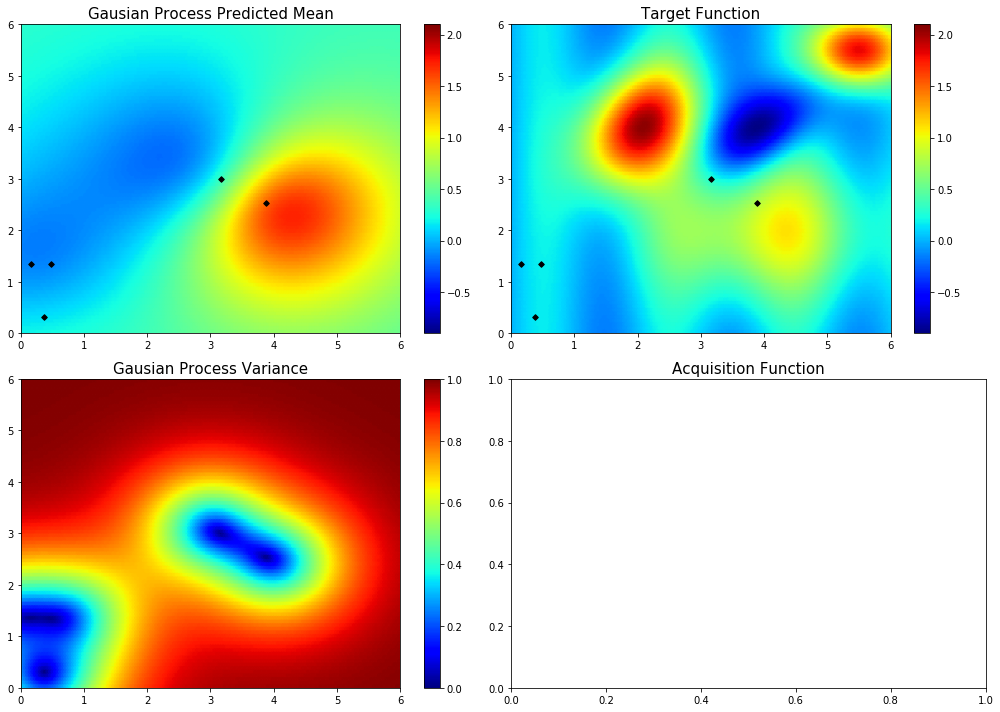

In [360]:
"""
#x = np.array([[res["params"]["x"]] for res in bo.res])
#y = np.array([[res["params"]["x"]] for res in bo.res])
#X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]
"""

plot_2d()


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  6        |  0.1703   |  0.5155   |  6.0      |
myplot:  006


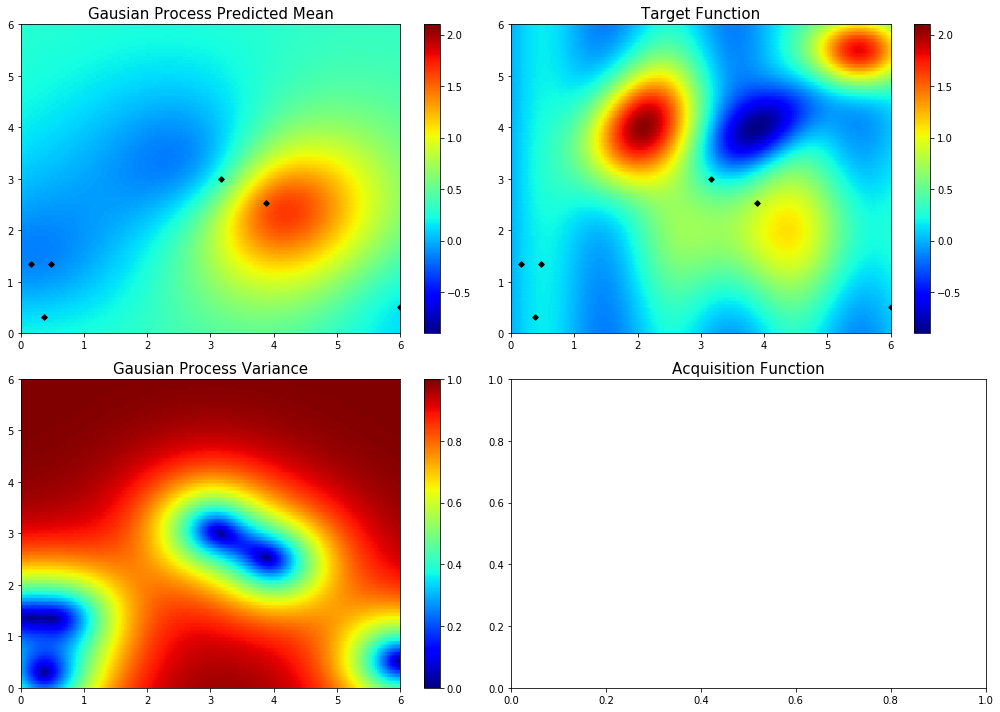

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  7        |  0.1418   |  4.2      |  6.0      |
myplot:  007


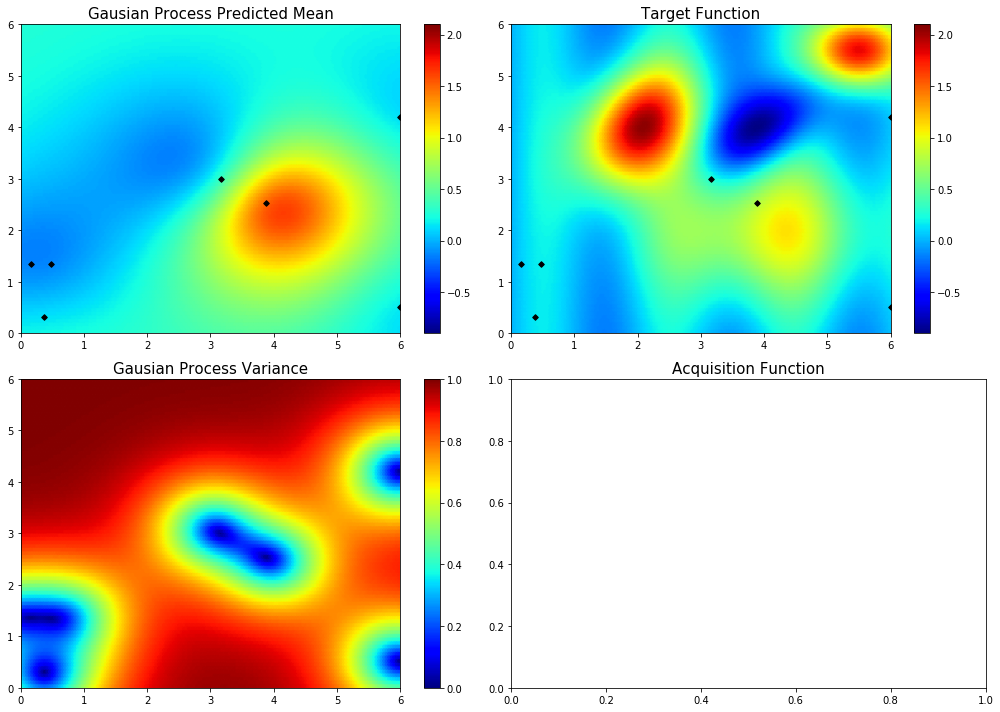

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  8        |  0.03558  |  6.0      |  0.0      |
myplot:  008


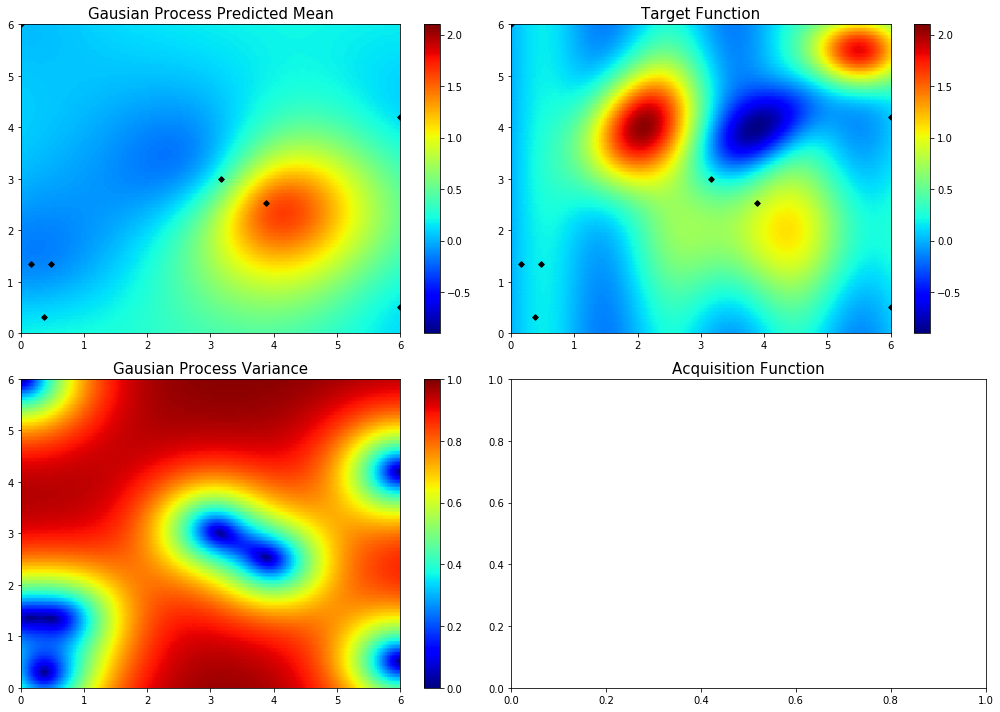

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  9        |  0.01247  |  0.0      |  3.332    |
myplot:  009


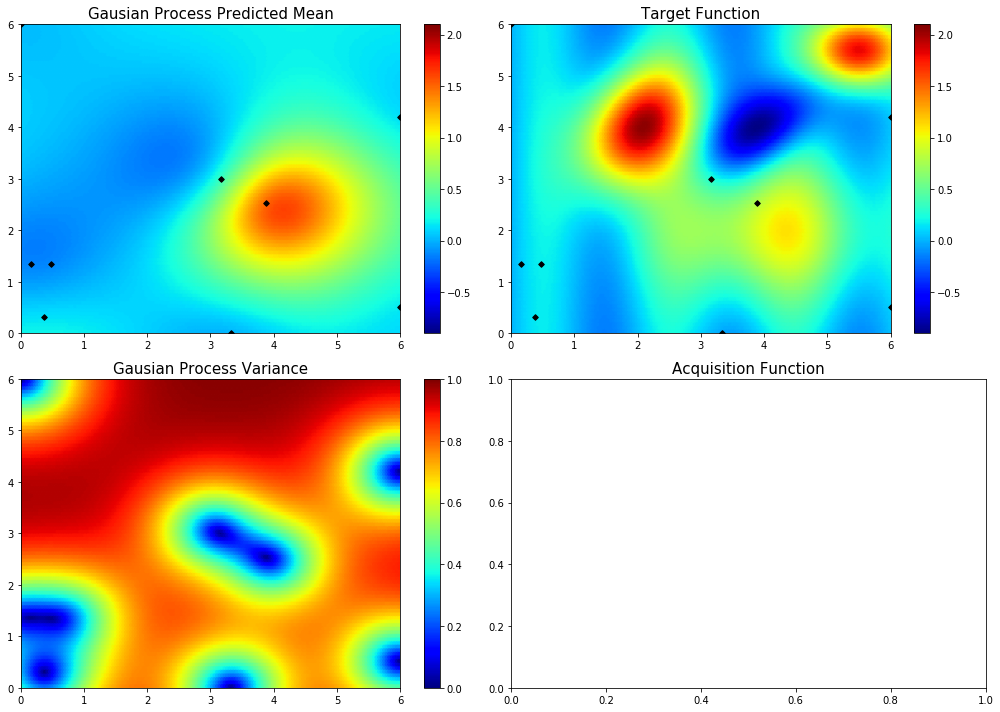

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  10       |  0.07809  |  6.0      |  3.564    |
myplot:  010


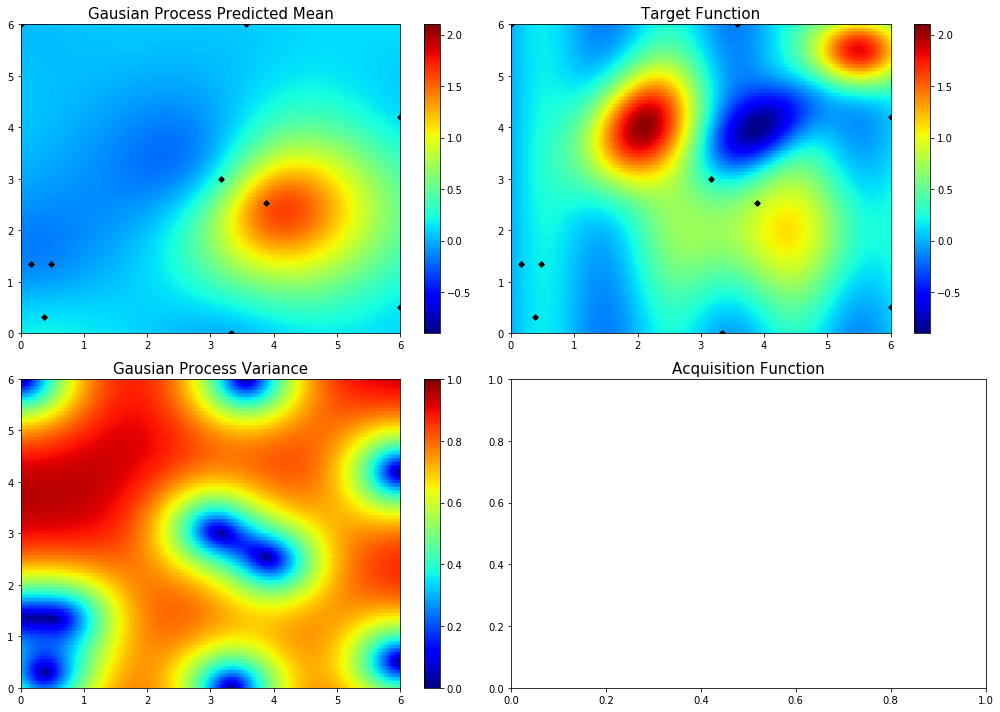

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  11       |  0.01214  |  3.75     |  0.0      |
myplot:  011


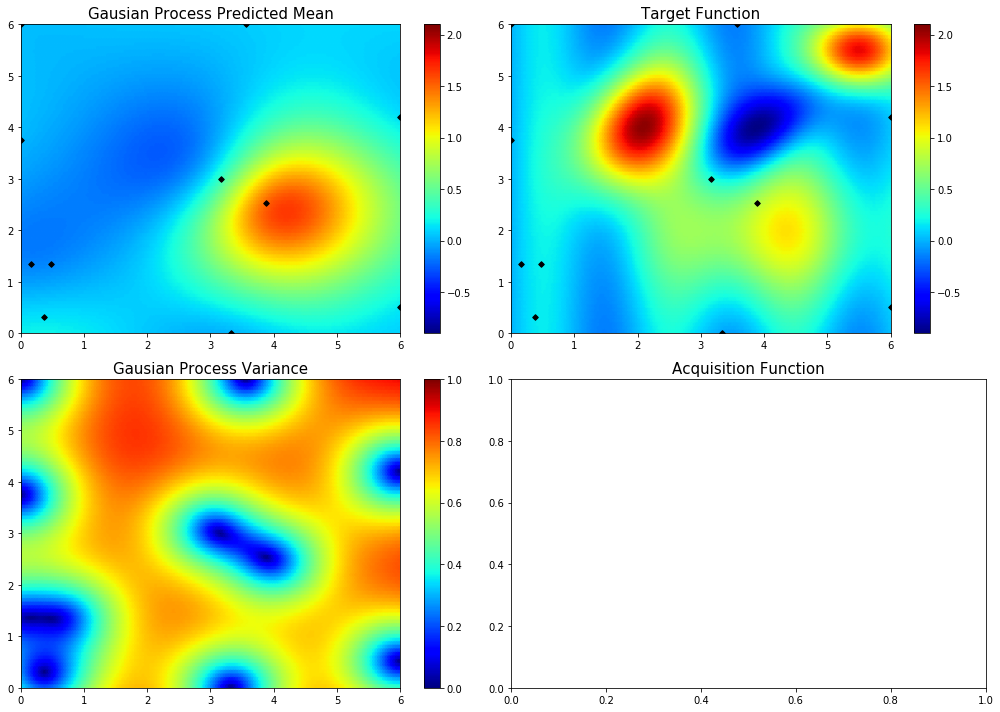

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  12       |  0.7354   |  6.0      |  6.0      |
myplot:  012


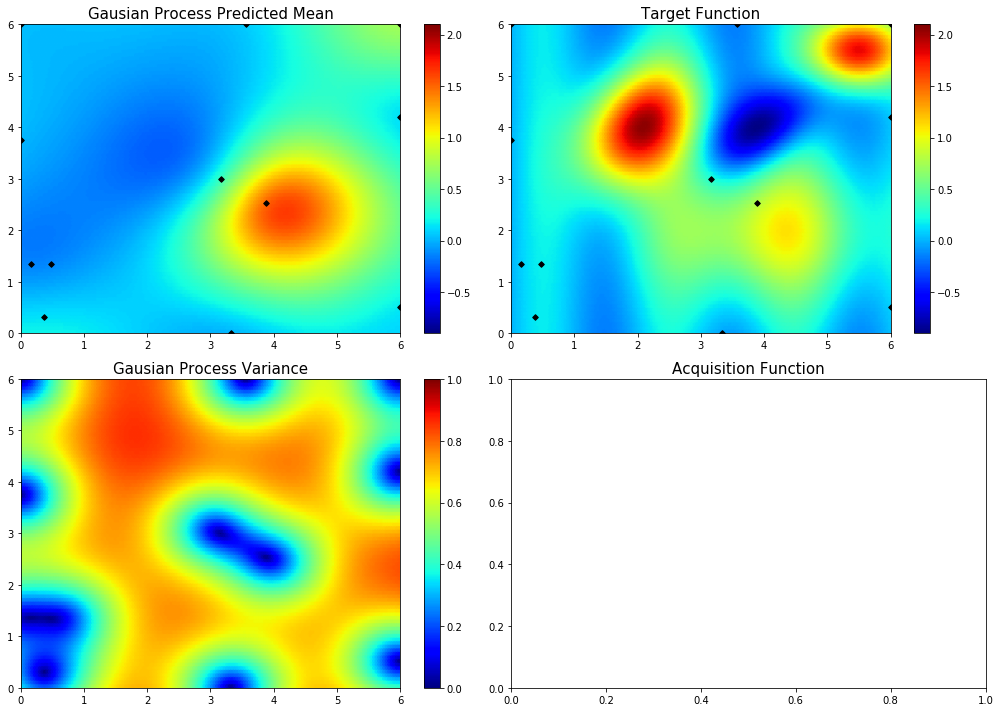

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  13       |  0.2379   |  2.327    |  6.0      |
myplot:  013


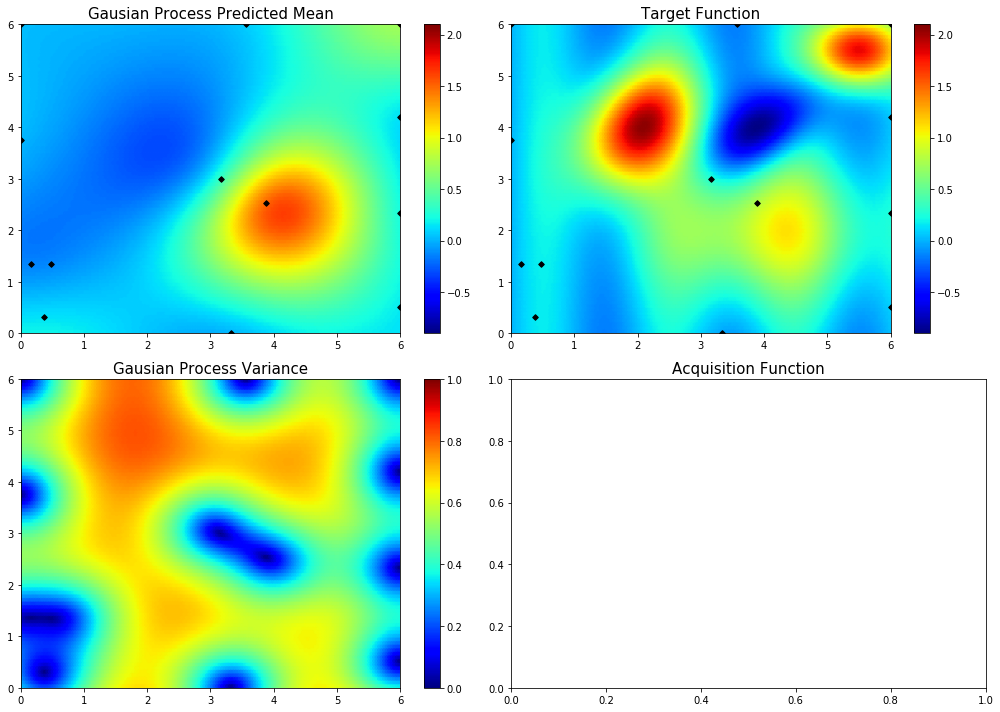

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  14       |  0.6487   |  5.051    |  1.784    |
myplot:  014


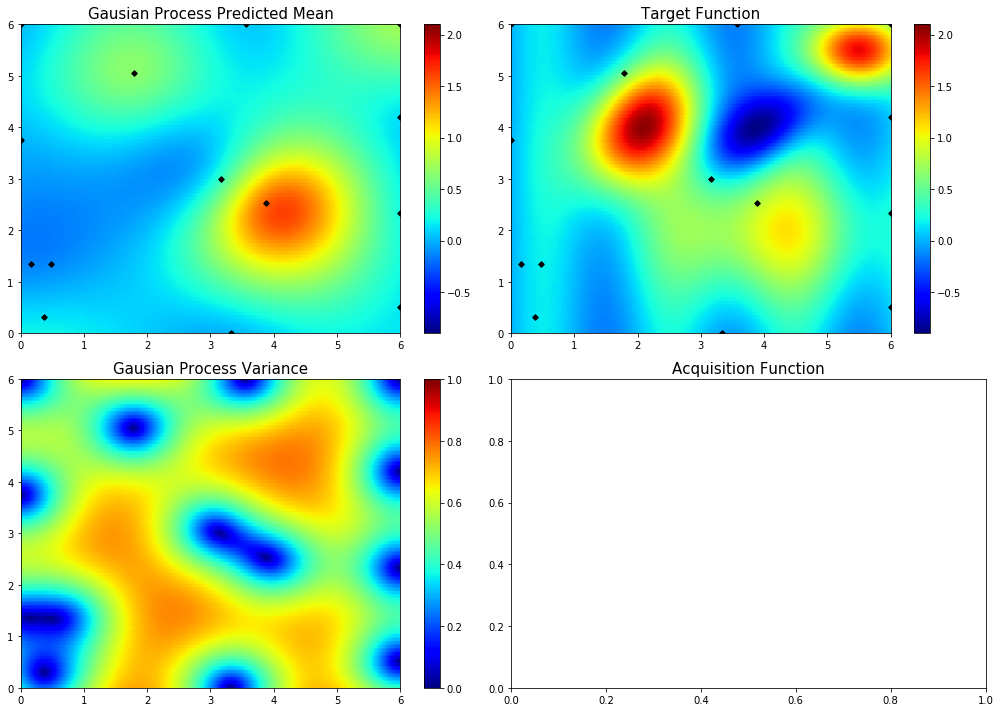

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  15       | -0.6473   |  4.276    |  4.283    |
myplot:  015


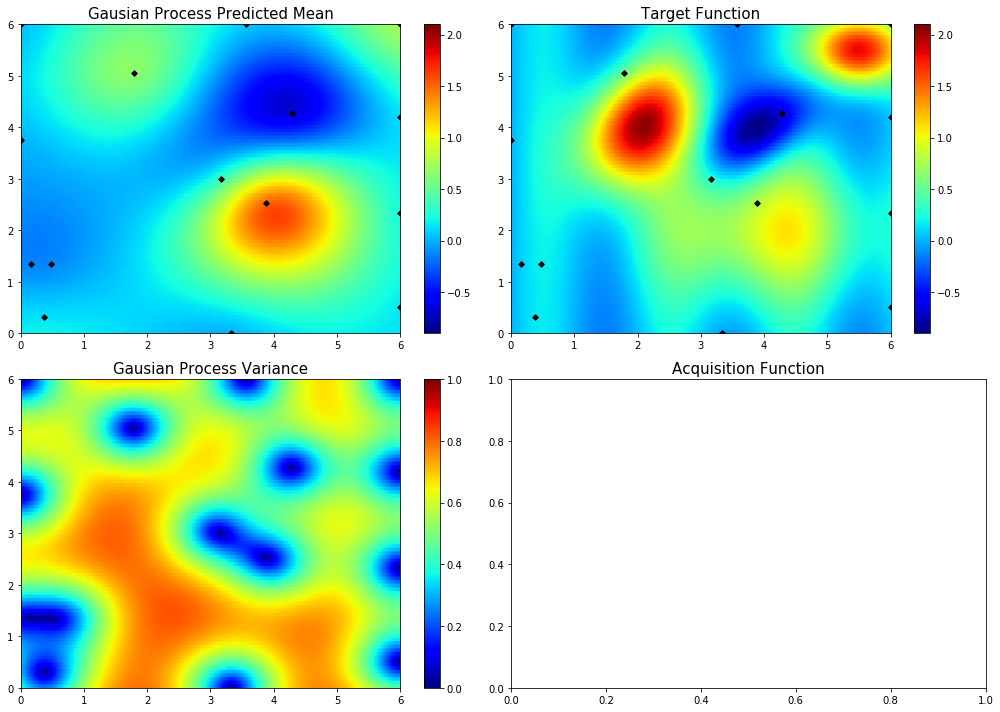

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  16       |  0.3091   |  1.49     |  2.542    |
myplot:  016


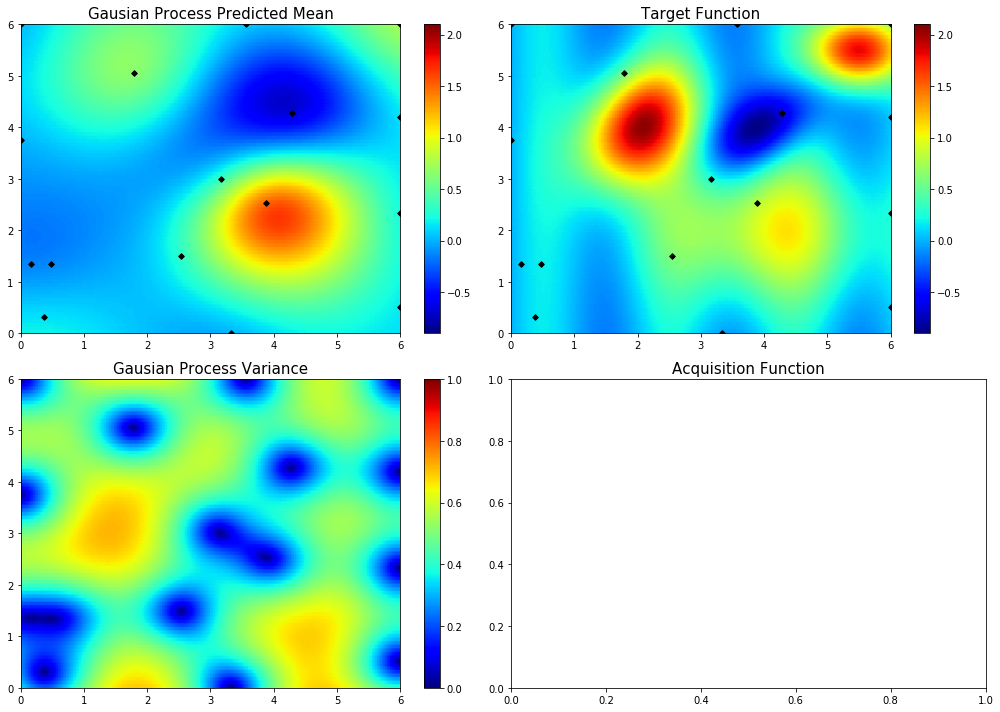

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  17       |  0.3862   |  1.182    |  4.512    |
myplot:  017


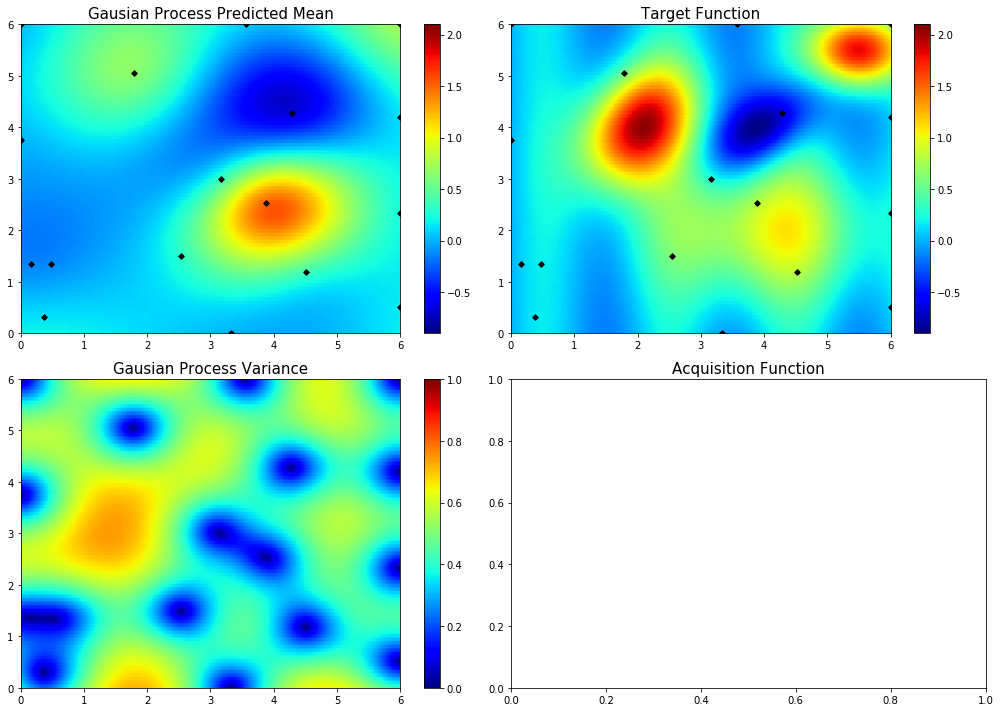

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  18       |  0.5969   |  3.135    |  1.441    |
myplot:  018


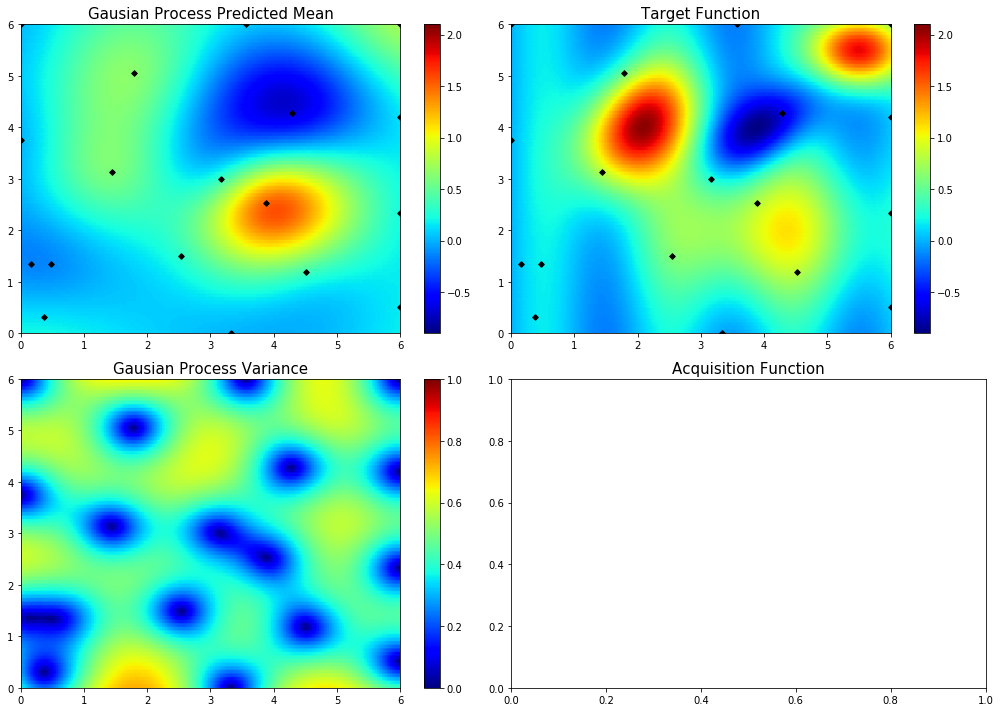

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  19       |  0.006614 |  0.0      |  1.81     |
myplot:  019


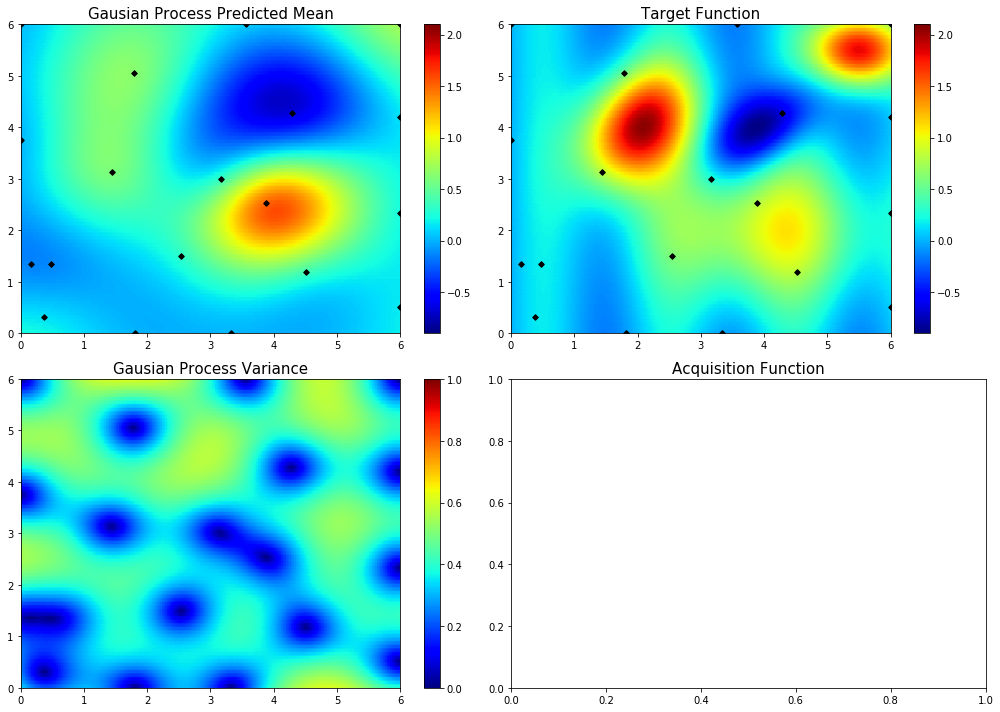

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  20       |  0.254    |  6.0      |  1.728    |
myplot:  020


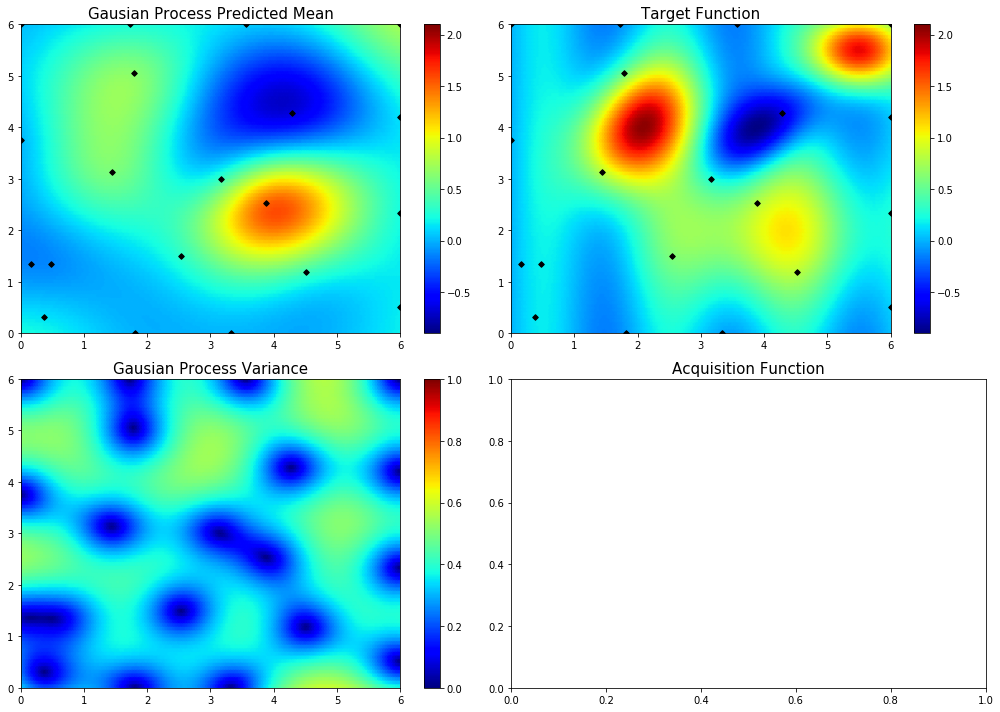

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  21       |  0.001245 |  0.0      |  4.875    |
myplot:  021


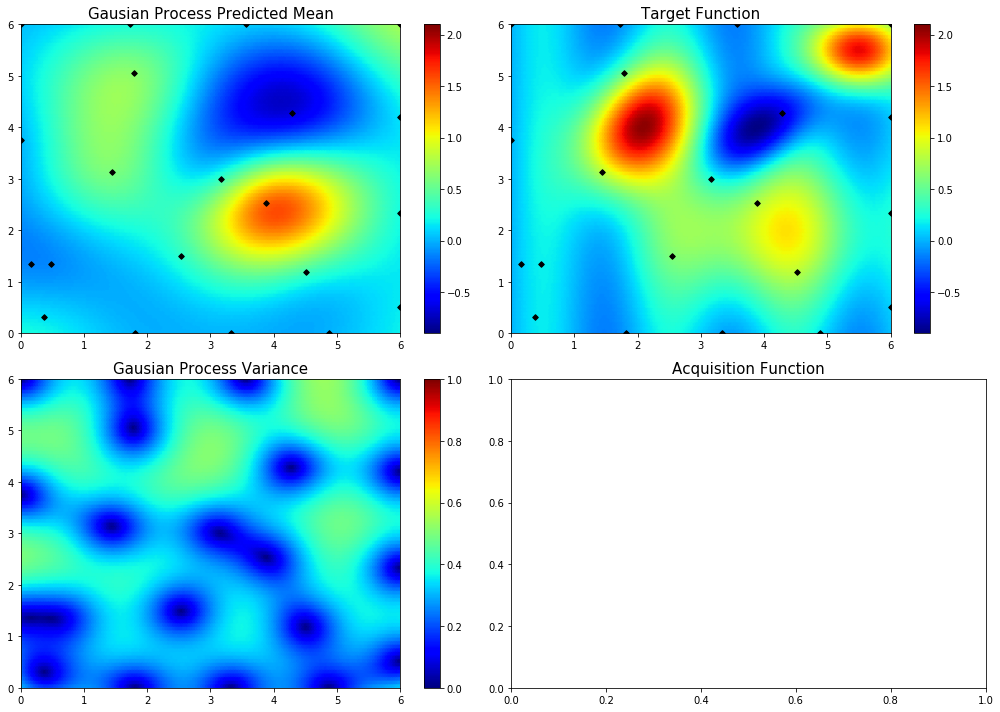

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  22       |  0.5313   |  6.0      |  4.856    |
myplot:  022


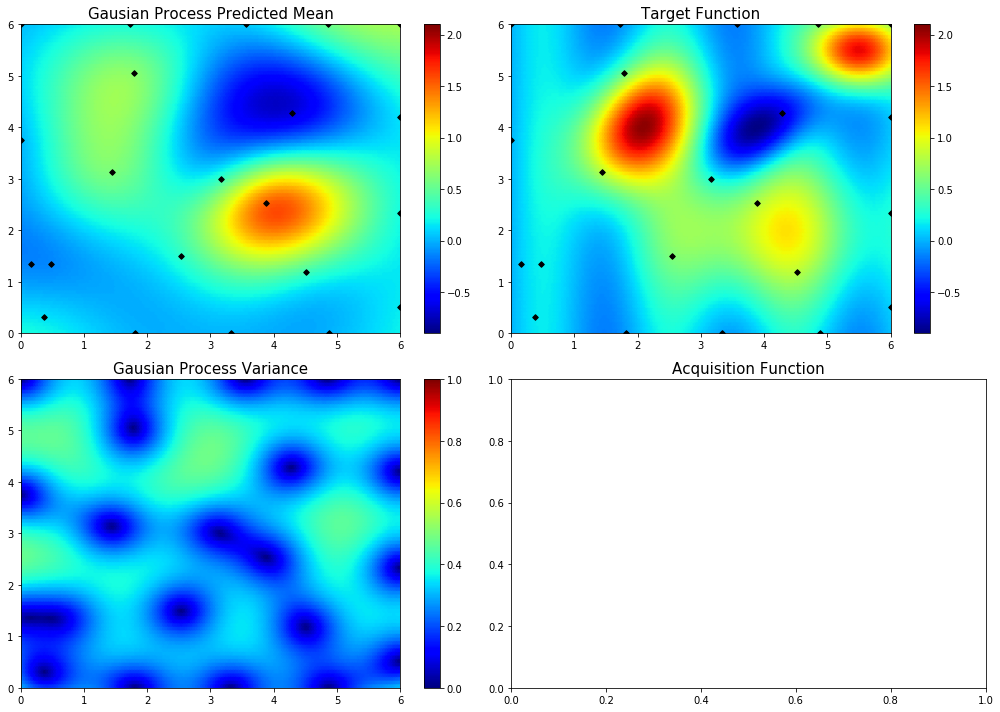

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  23       |  0.5119   |  2.936    |  4.947    |
myplot:  023


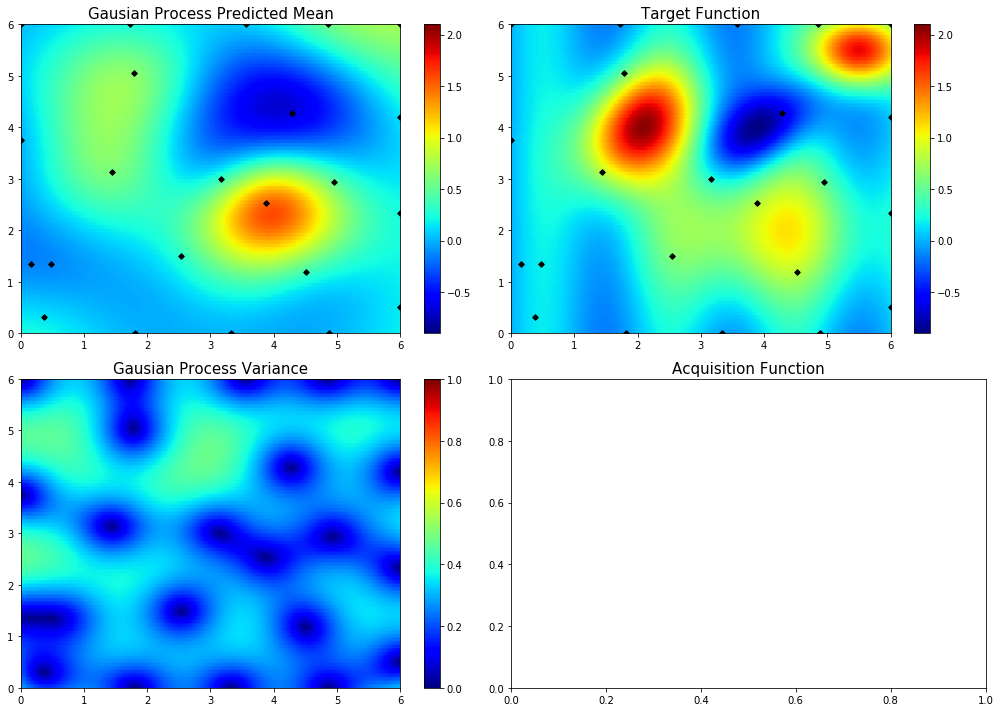

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  24       |  0.4043   |  4.823    |  0.6348   |
myplot:  024


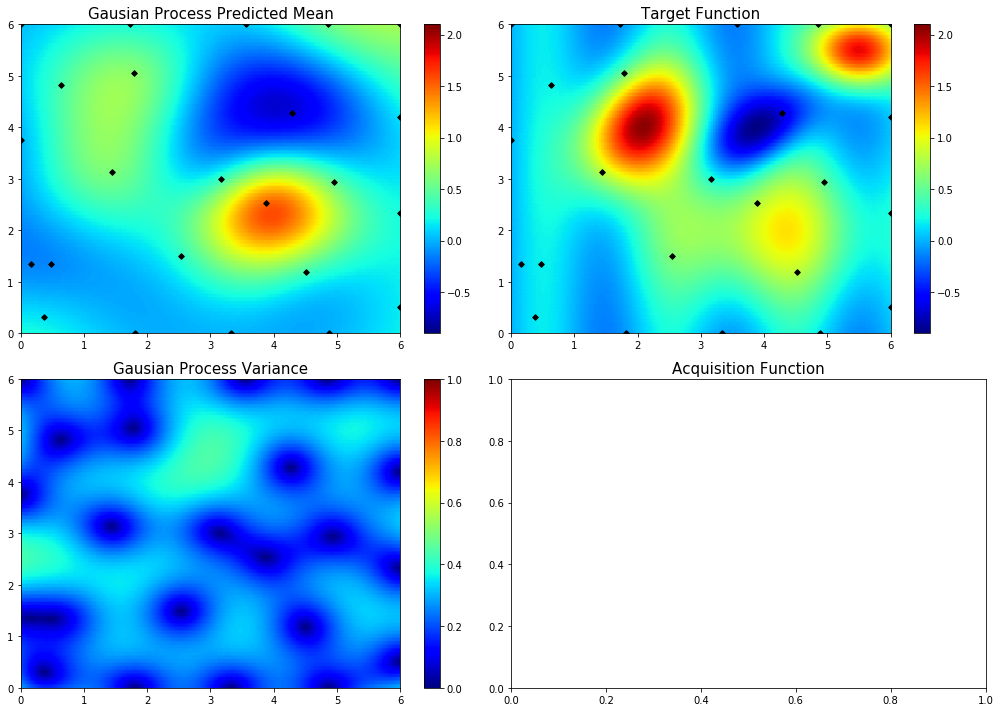

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  25       |  0.2345   |  2.567    |  0.0      |
myplot:  025


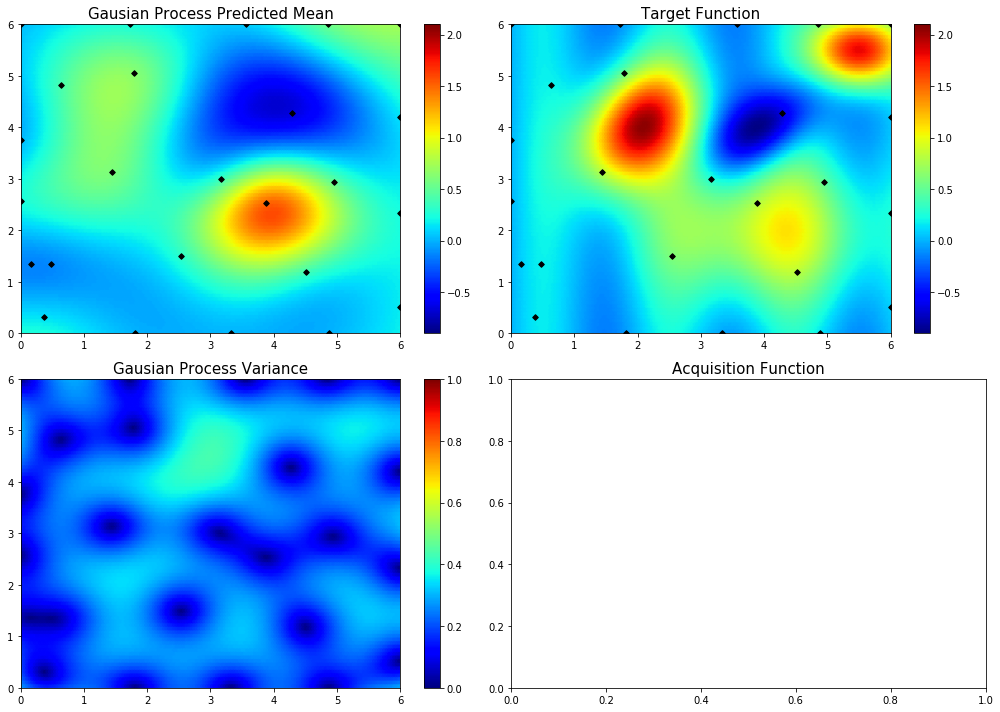

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  26       |  0.8488   |  4.437    |  2.777    |
myplot:  026


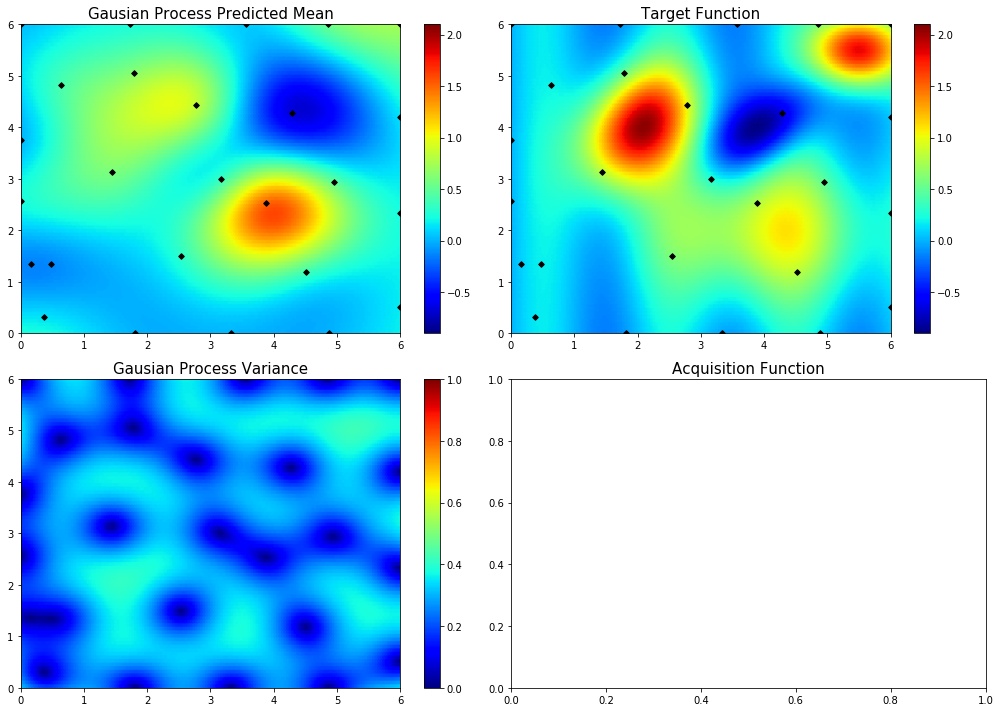

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  27       |  1.419    |  1.614    |  3.565    |
myplot:  027


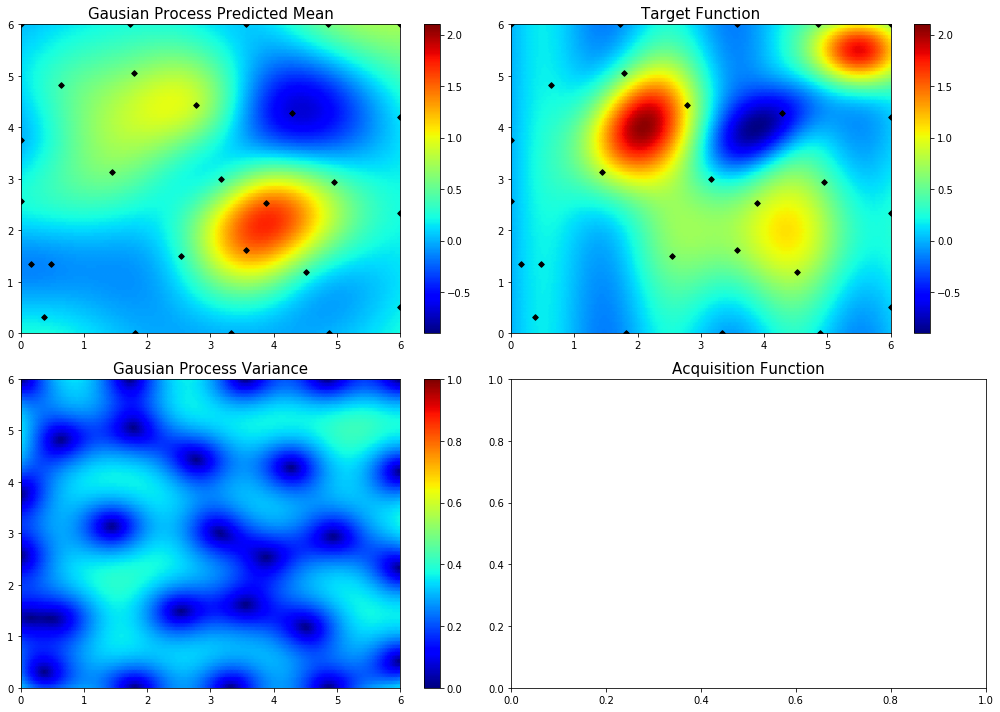

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  28       |  0.9925   |  4.036    |  1.769    |
myplot:  028


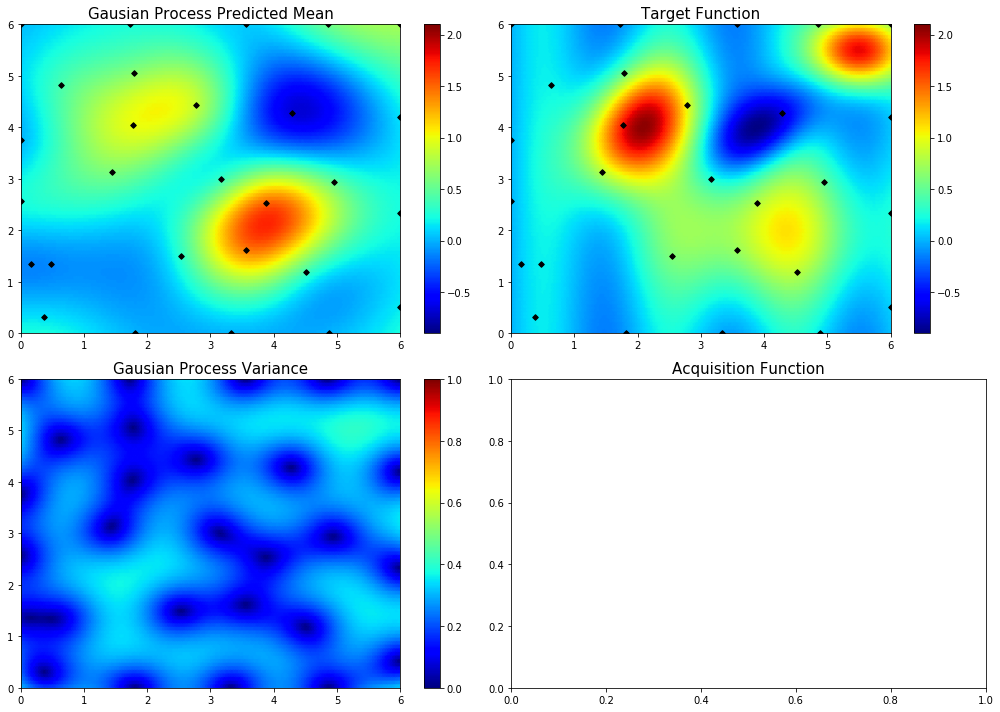

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  29       |  1.459    |  5.148    |  5.479    |
myplot:  029


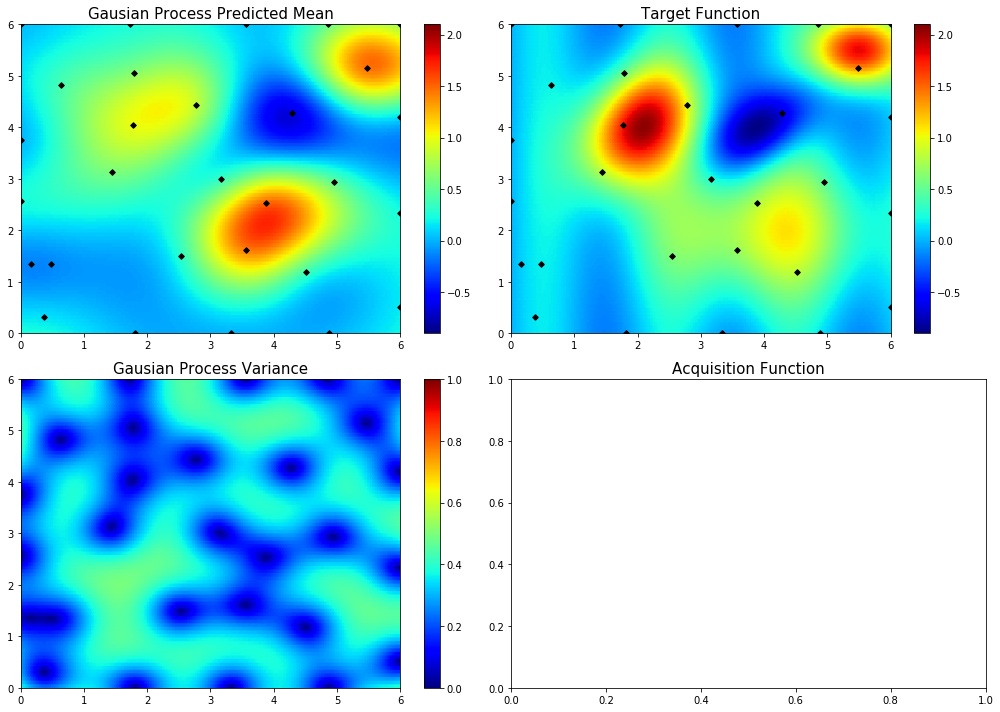

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  30       |  1.044    |  2.021    |  4.901    |
myplot:  030


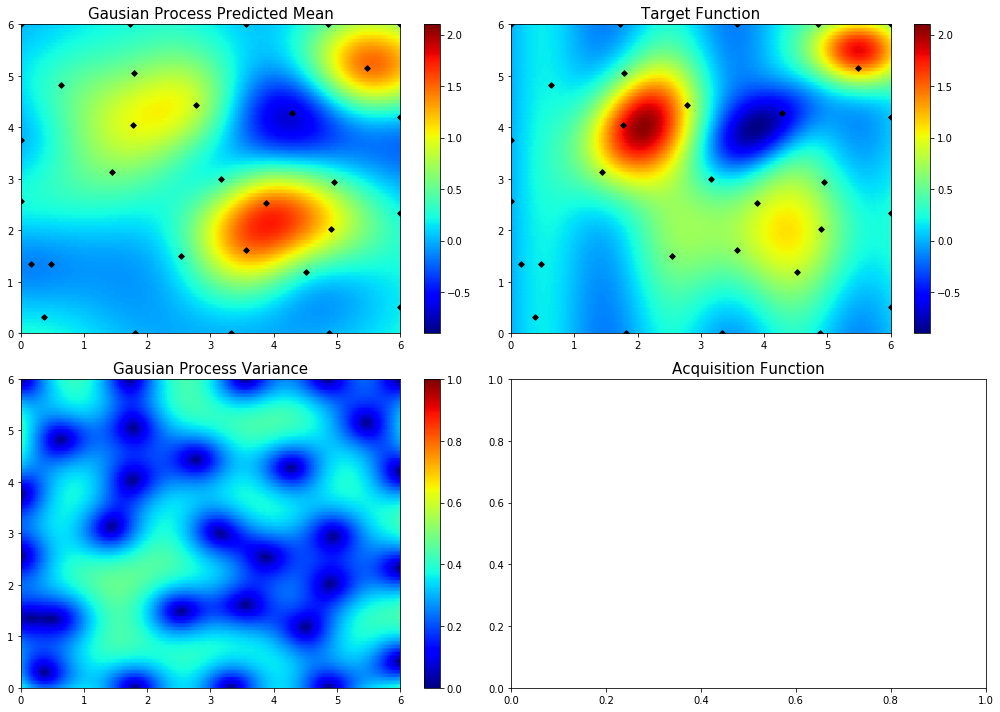

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  31       |  0.3214   |  2.079    |  1.575    |
myplot:  031


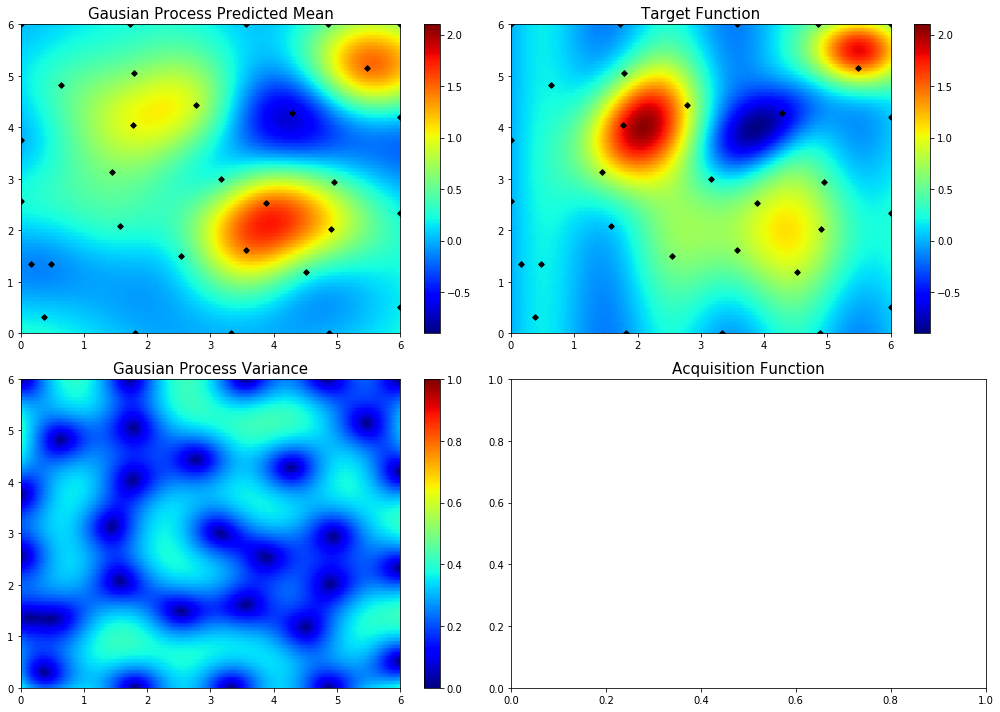

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  32       |  0.1977   |  5.509    |  2.695    |
myplot:  032


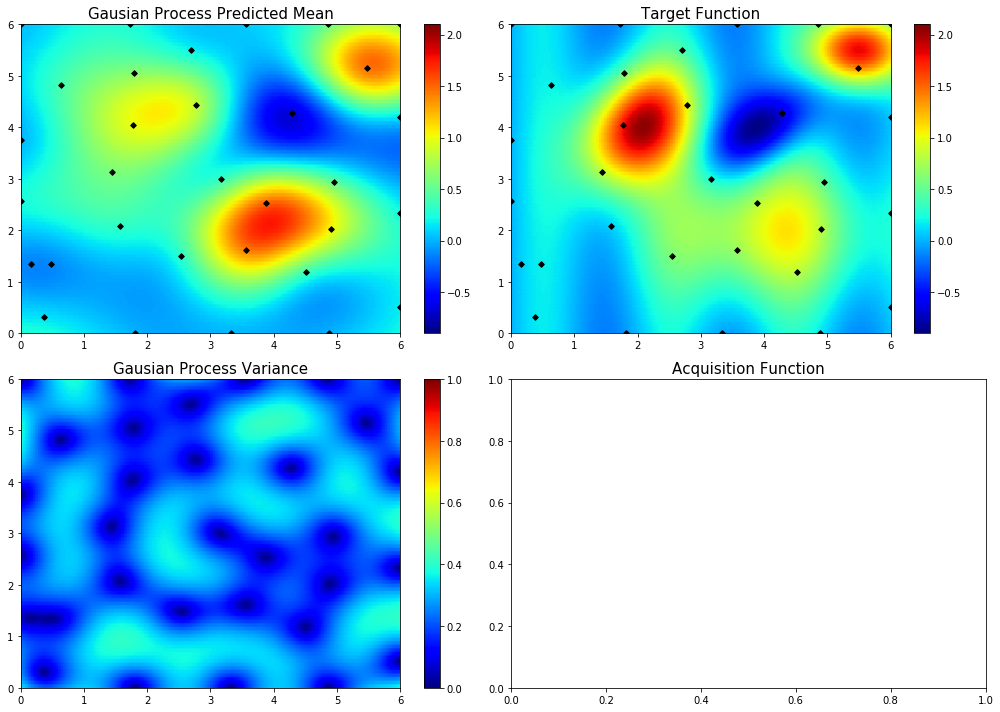

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  33       | -0.1433   |  1.42     |  6.0      |
myplot:  033


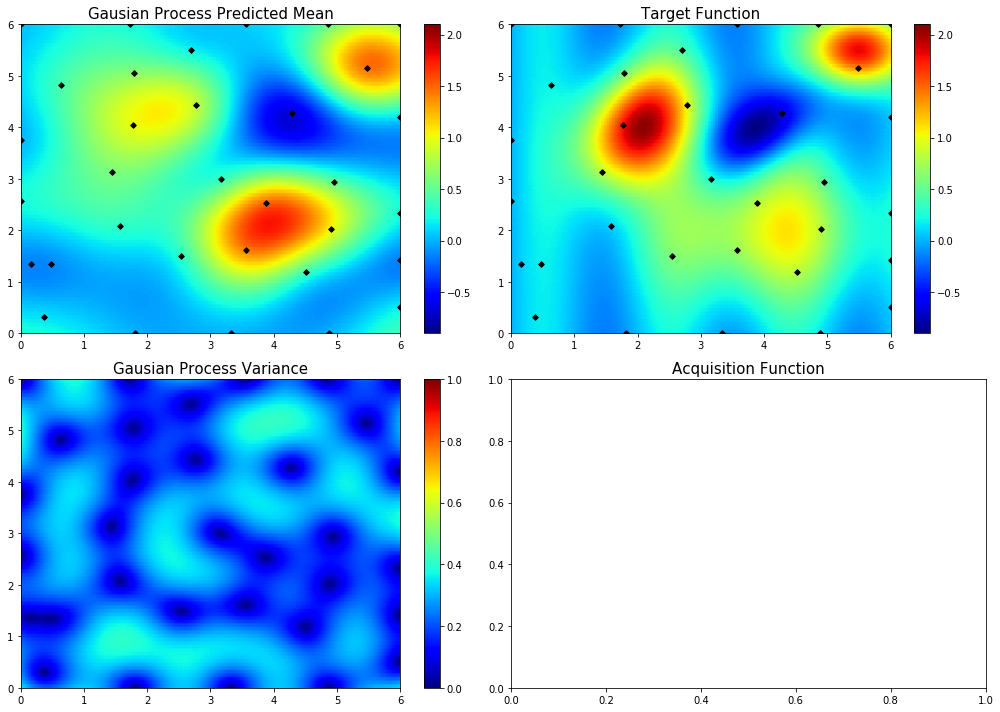

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  34       |  0.8753   |  5.156    |  6.0      |
myplot:  034


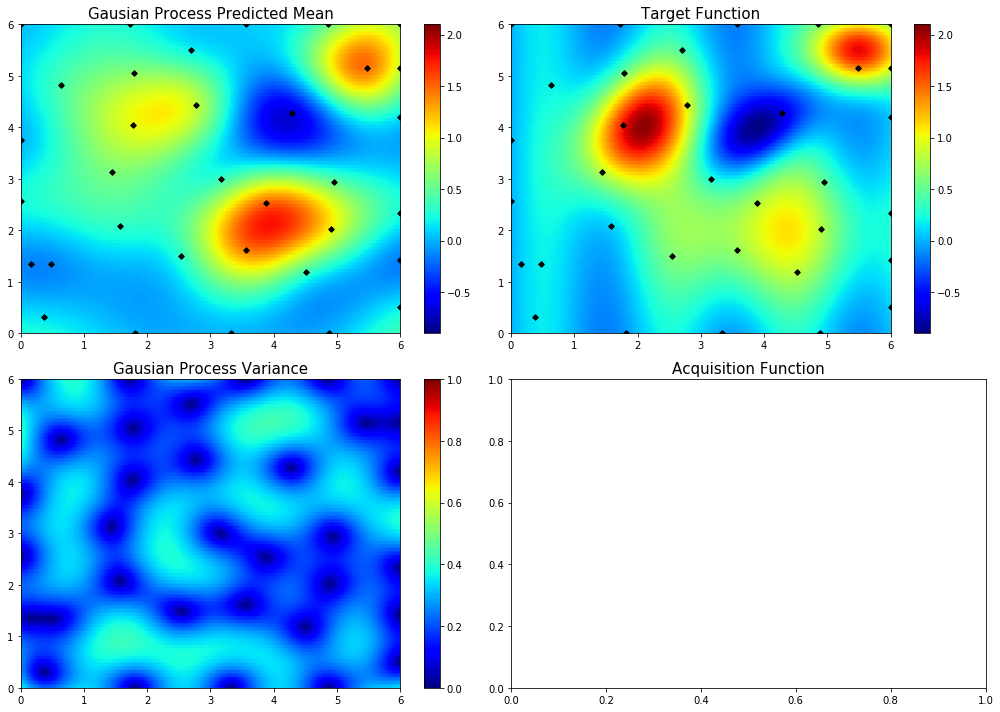

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  35       | -0.06683  |  5.27     |  4.256    |
myplot:  035


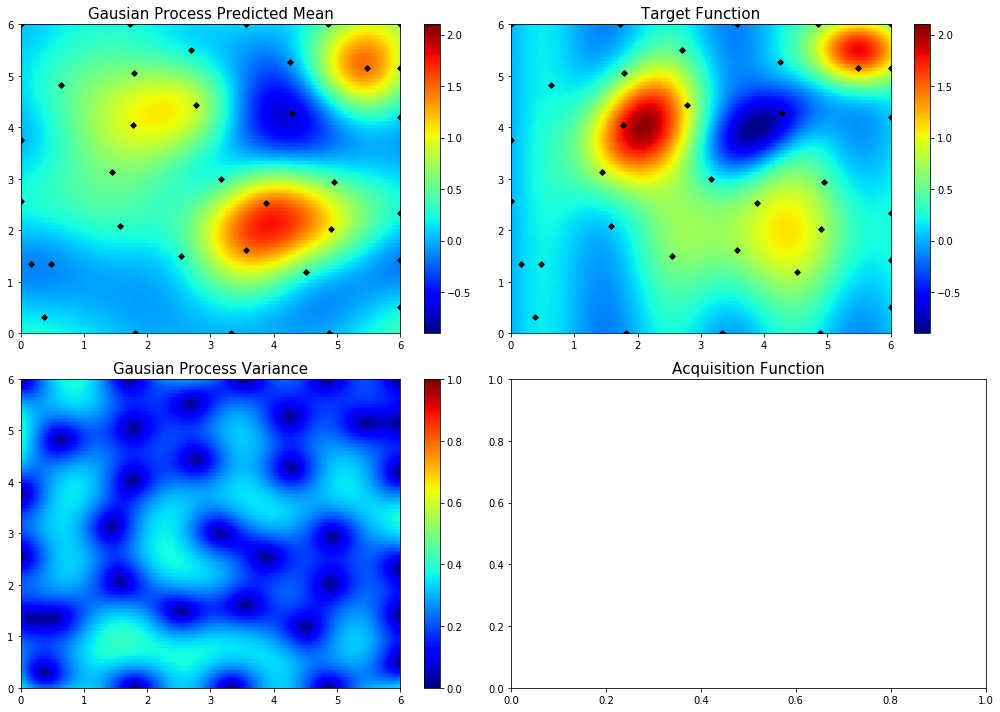

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  36       |  0.7049   |  2.553    |  2.384    |
myplot:  036


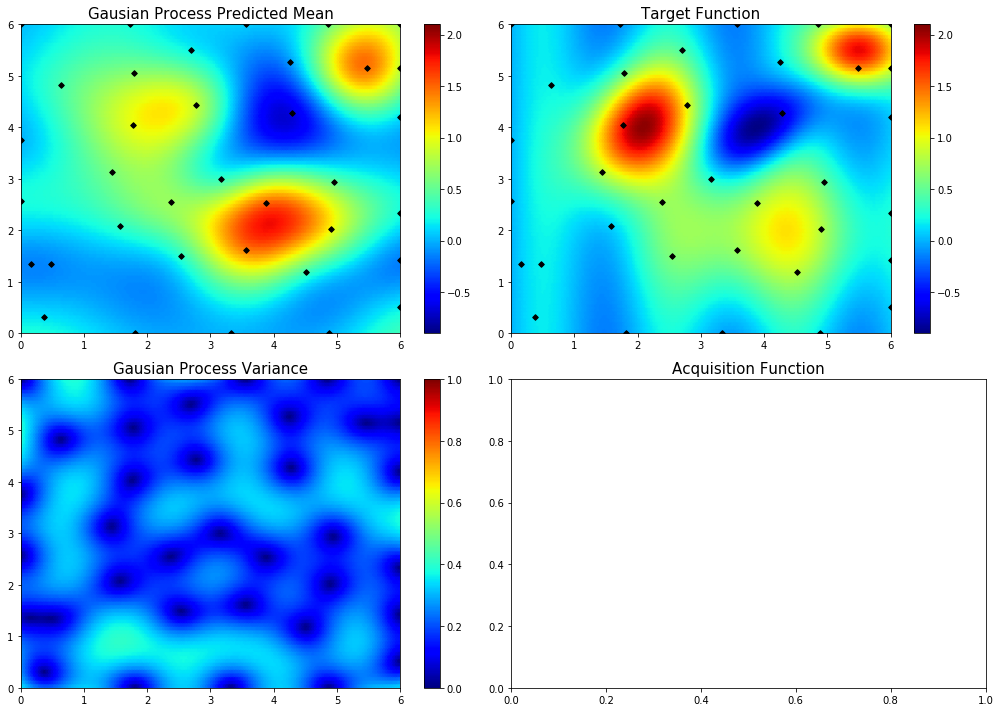

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  37       |  0.1364   |  6.0      |  0.853    |
myplot:  037


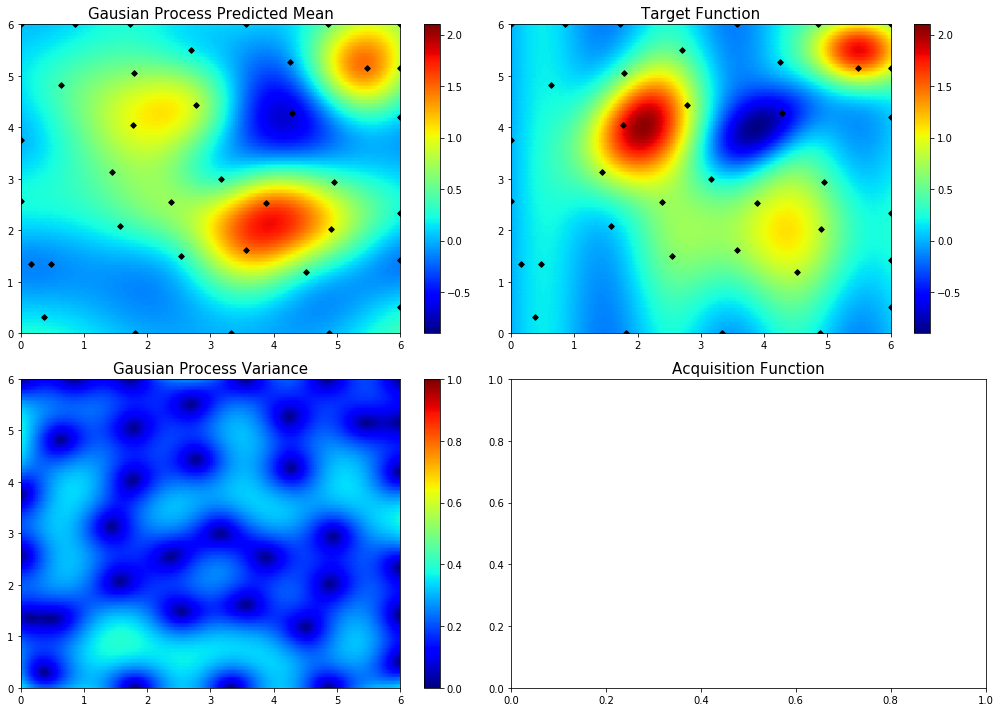

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  38       |  0.1021   |  4.992    |  0.0      |
myplot:  038


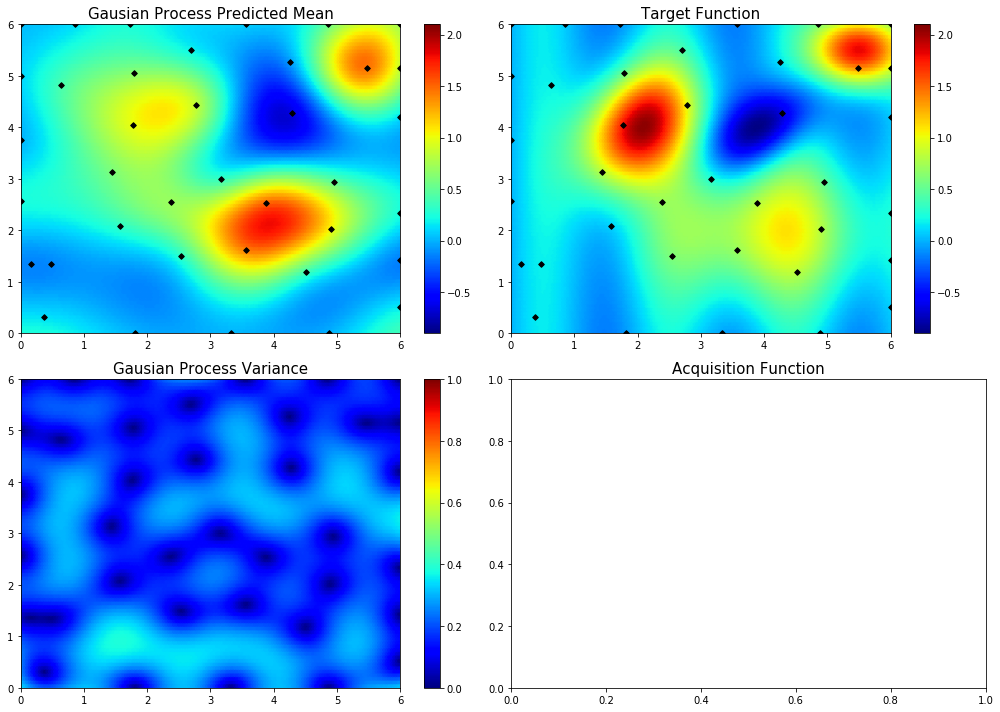

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  39       |  0.000655 |  0.0      |  0.0      |
myplot:  039


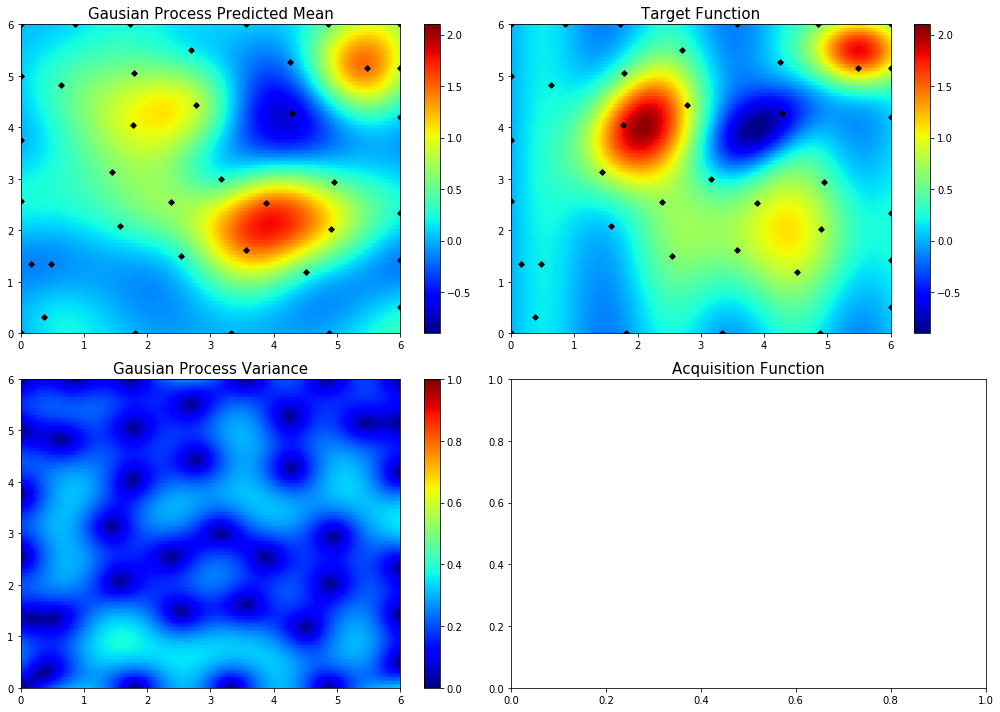

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  40       |  0.09869  |  0.9123   |  1.576    |
myplot:  040


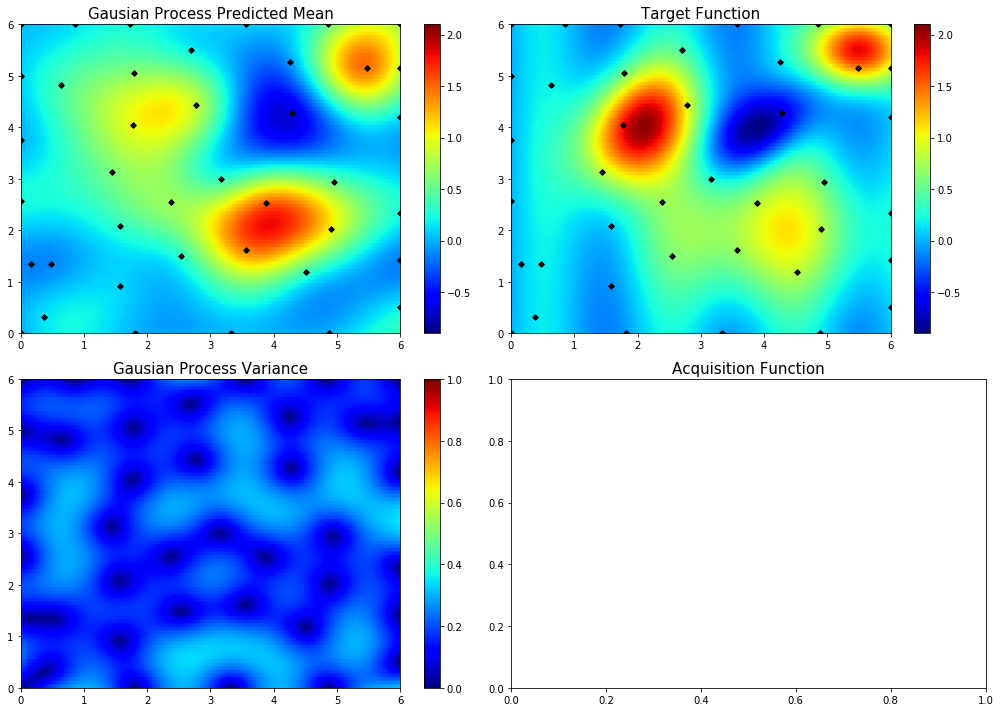

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  41       |  0.6925   |  3.559    |  2.378    |
myplot:  041


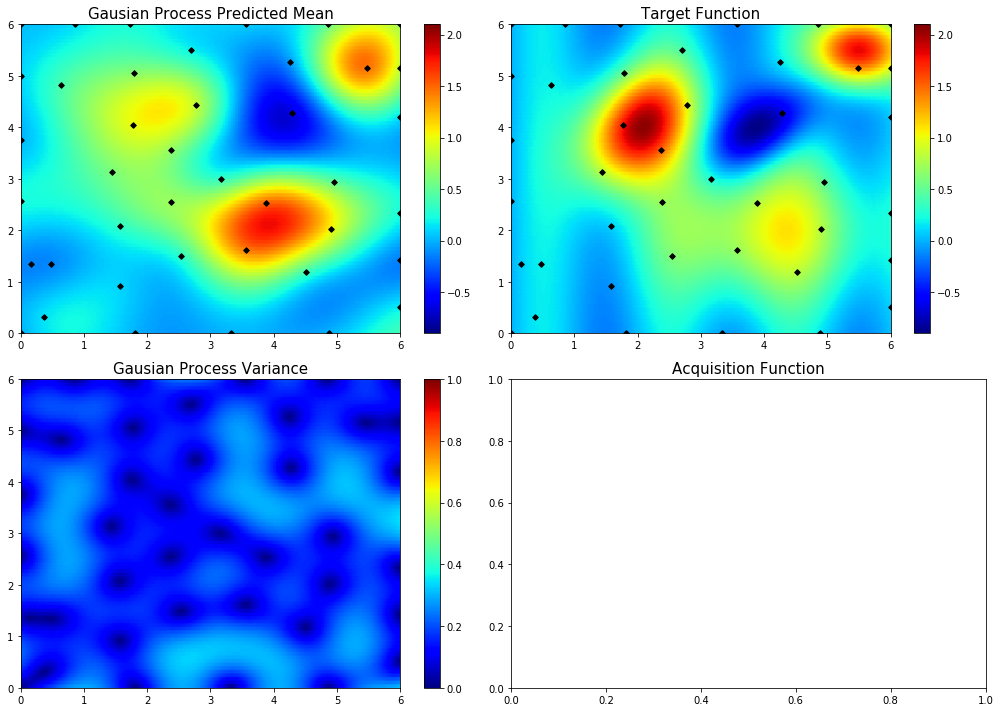

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  42       |  2.094e-0 |  0.0      |  6.0      |
myplot:  042


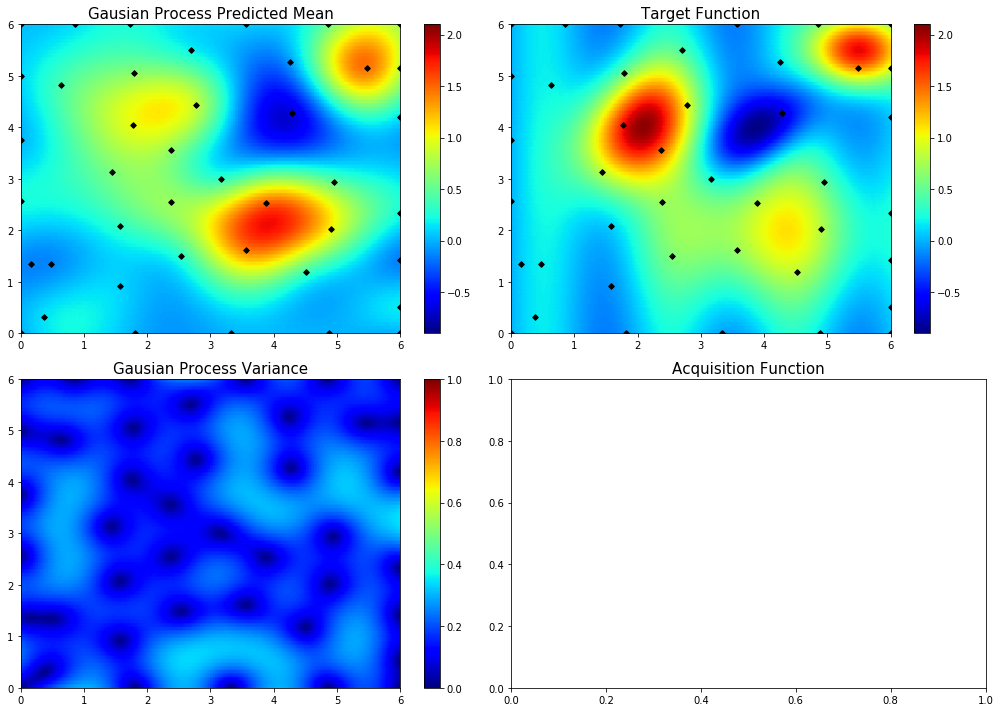

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  43       |  1.953    |  1.97     |  4.168    |
myplot:  043


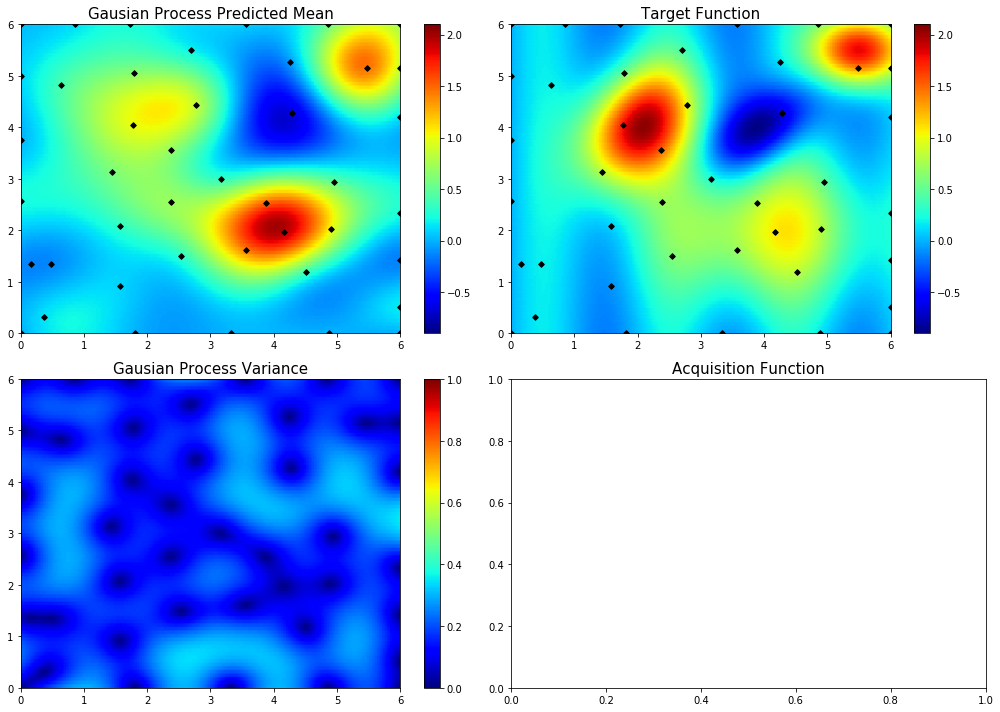

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  44       | -0.07826  |  3.239    |  6.0      |
myplot:  044


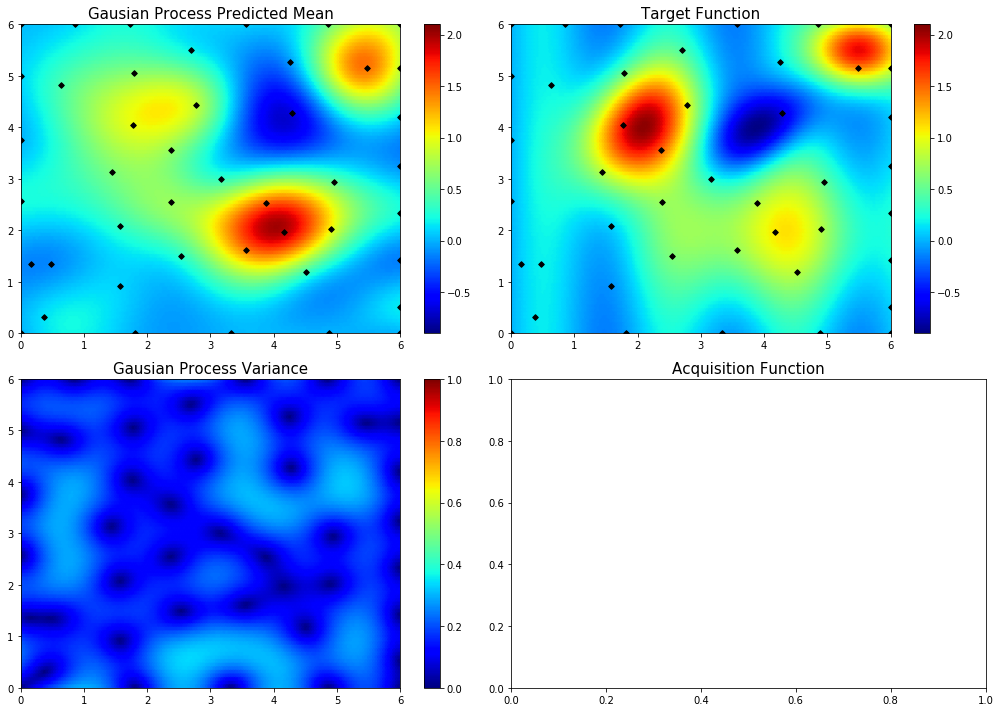

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  45       |  1.38     |  2.17     |  3.281    |
myplot:  045


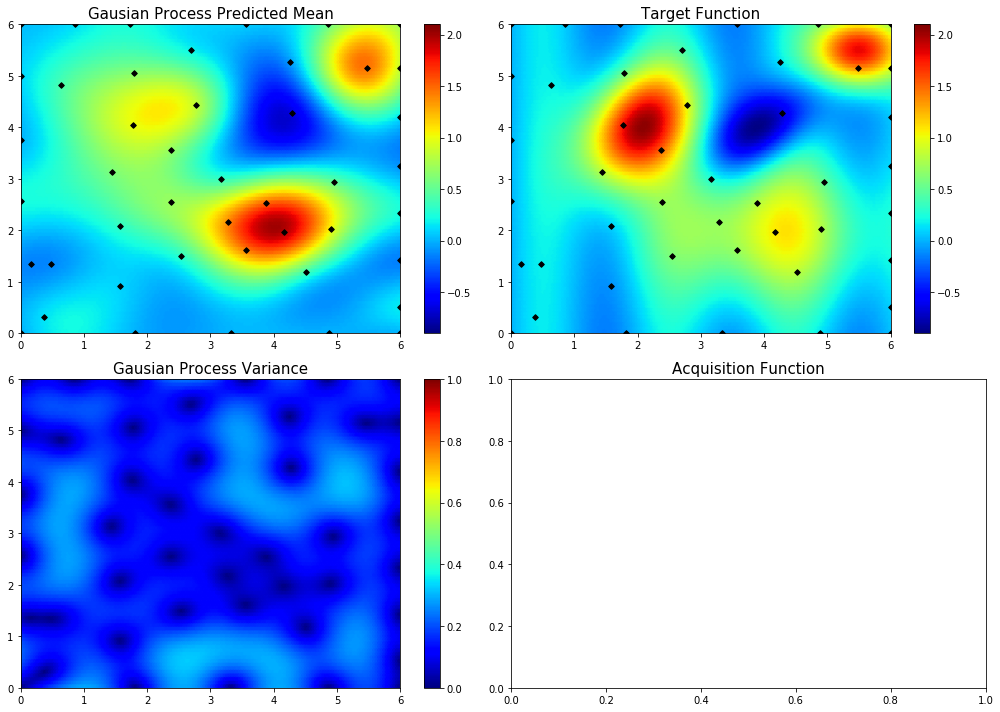

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  46       |  0.4512   |  3.841    |  0.885    |
myplot:  046


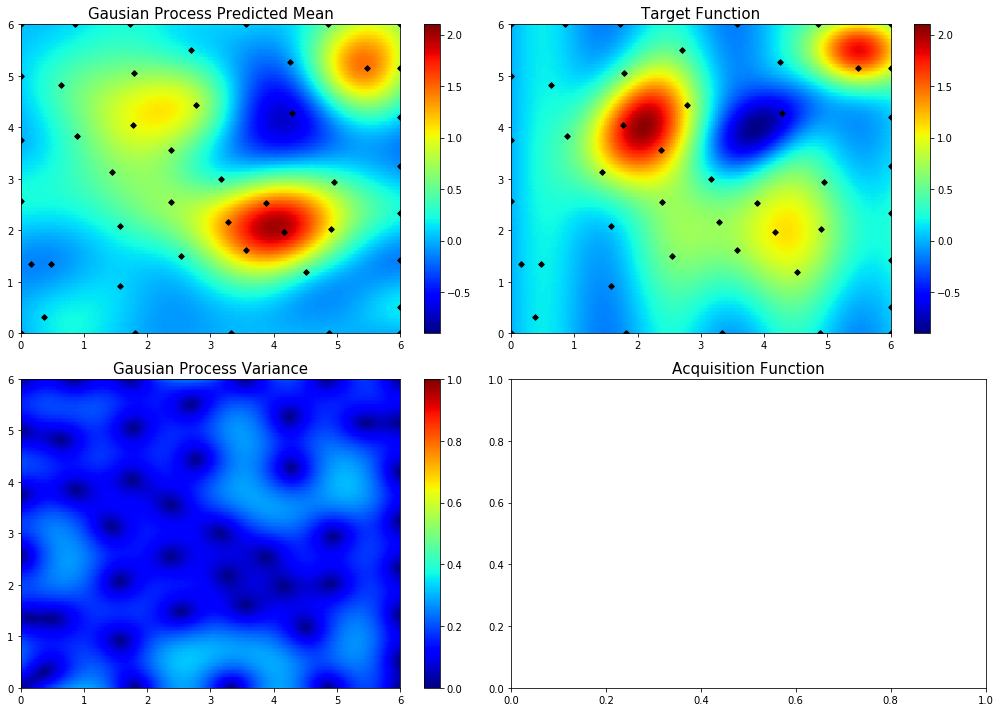

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  47       |  0.2167   |  4.393    |  5.22     |
myplot:  047


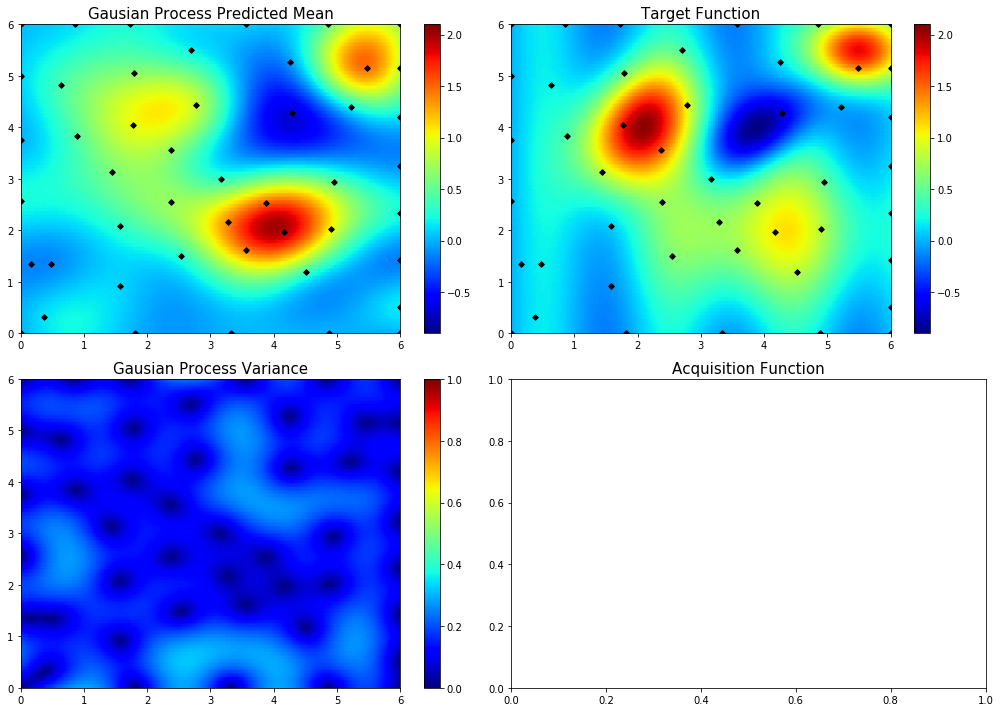

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  48       |  0.2638   |  0.5689   |  2.684    |
myplot:  048


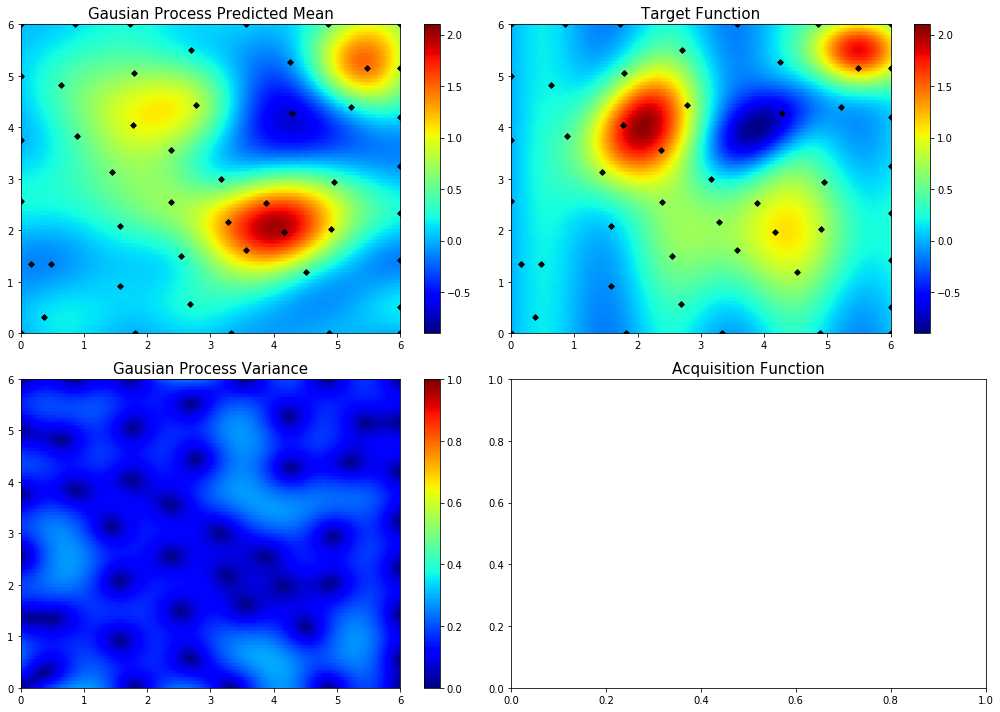

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  49       |  0.3685   |  0.7332   |  3.727    |
myplot:  049


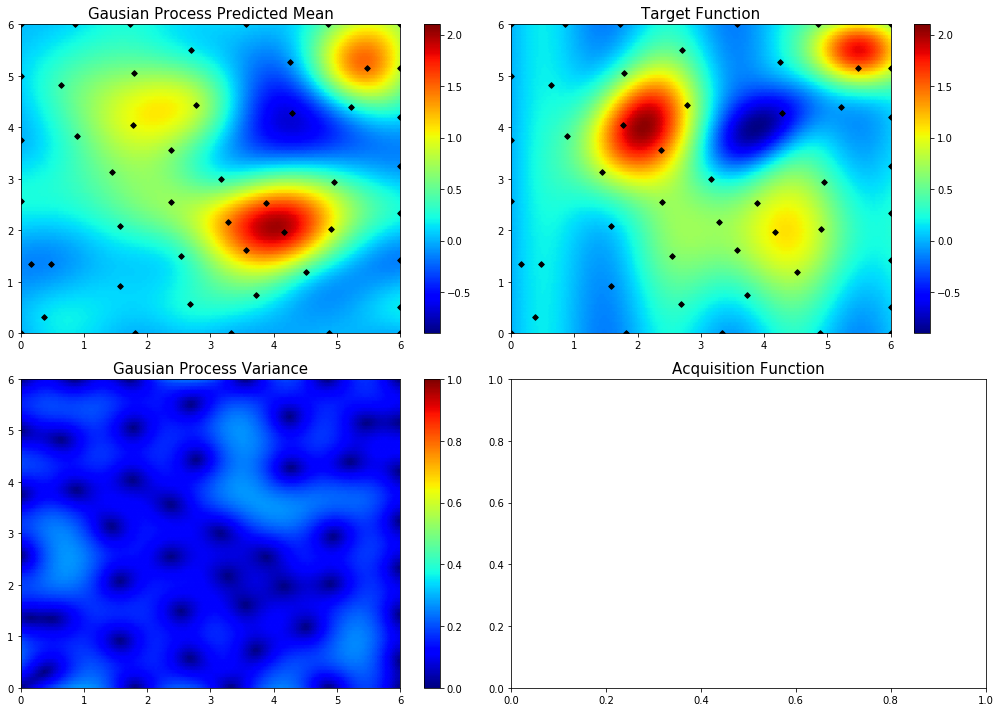

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  50       |  0.4052   |  2.6      |  0.7676   |
myplot:  050


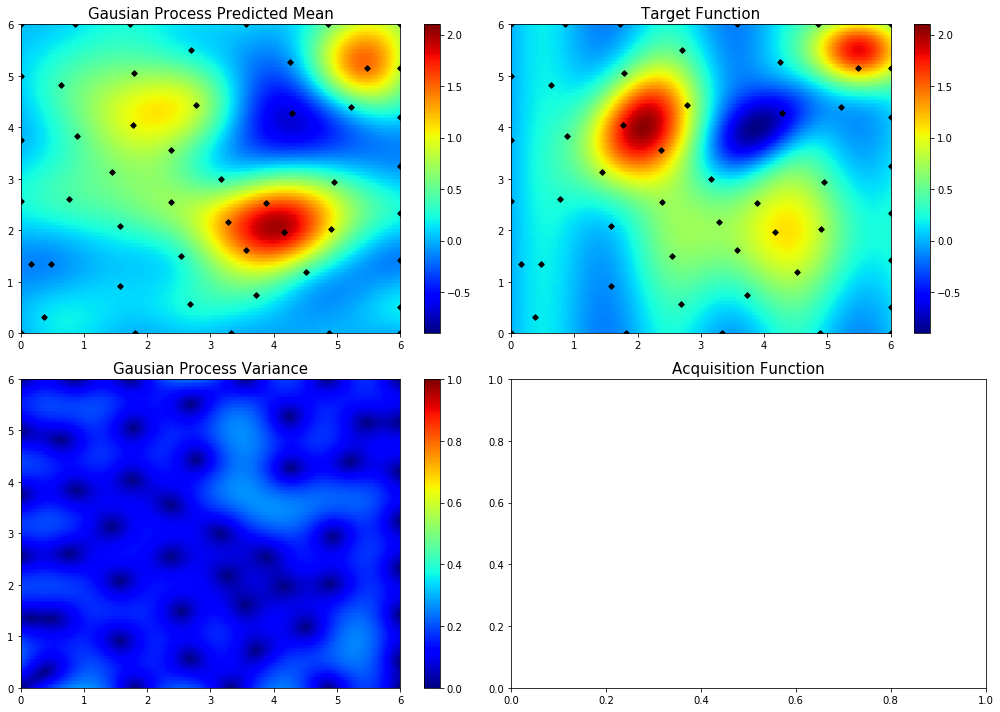

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  51       |  1.695    |  2.409    |  4.426    |
myplot:  051


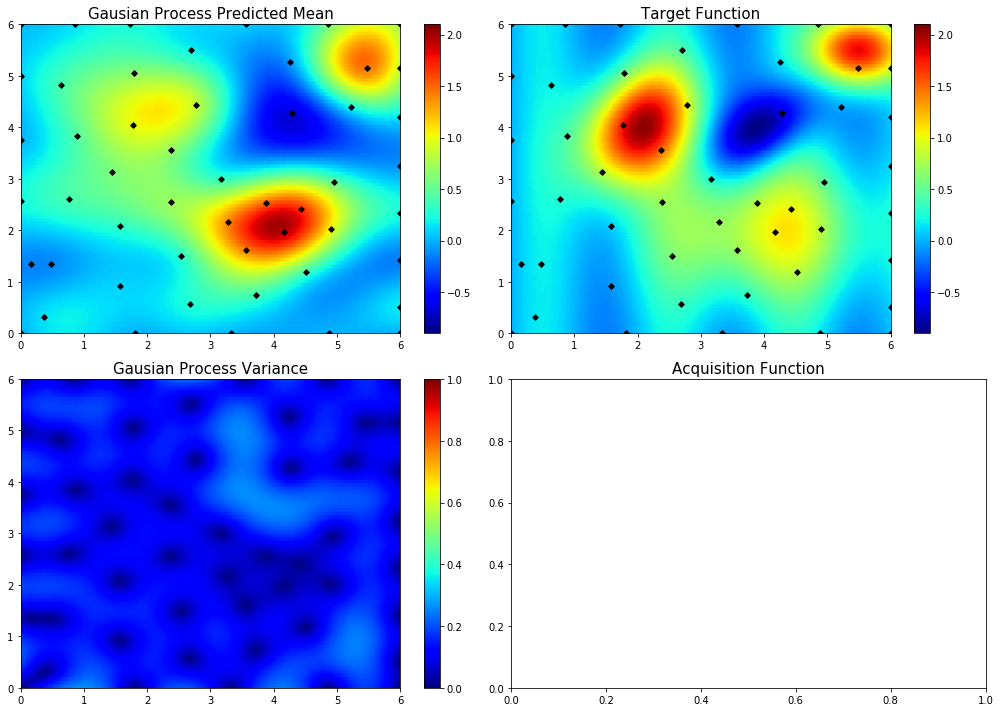

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  52       |  0.002986 |  0.0      |  0.9719   |
myplot:  052


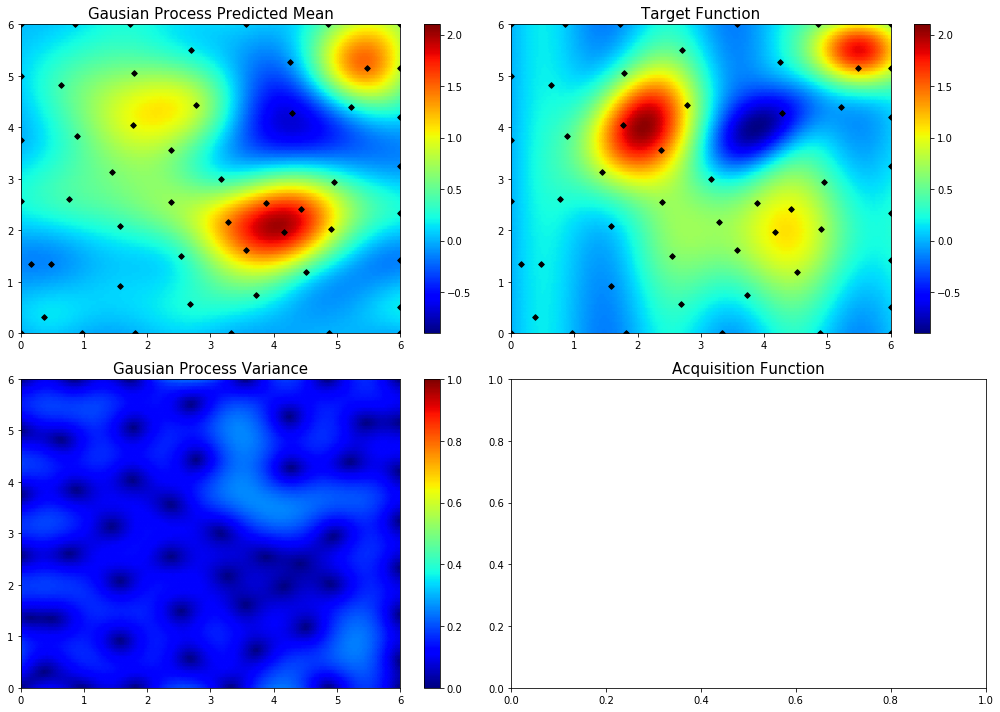

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  53       |  1.716    |  5.685    |  5.467    |
myplot:  053


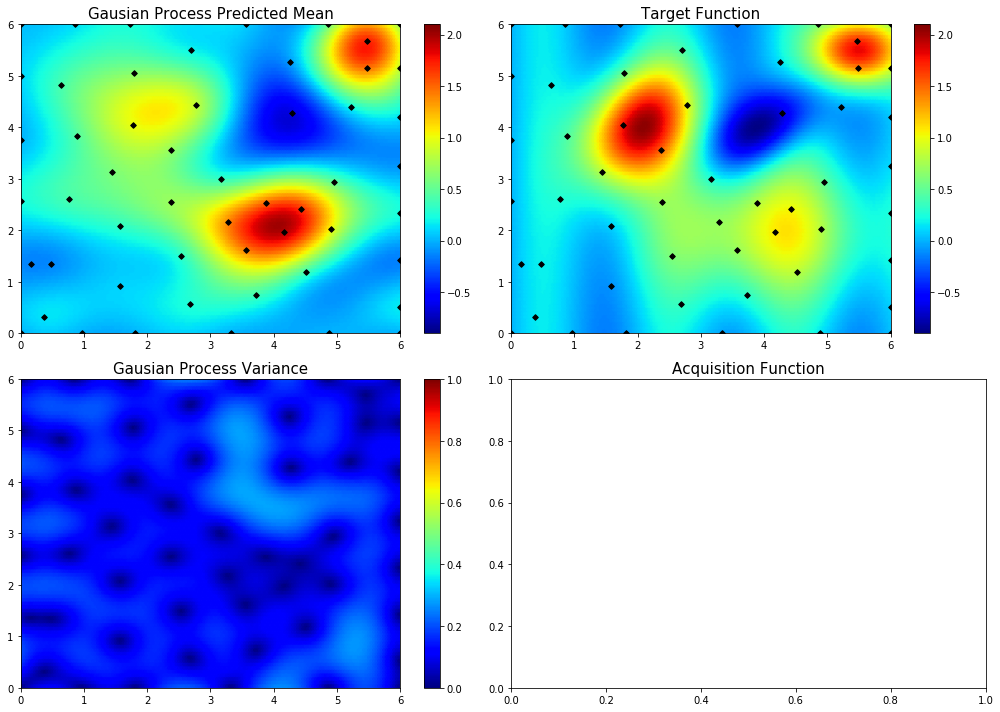

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  54       |  0.2961   |  4.942    |  3.375    |
myplot:  054


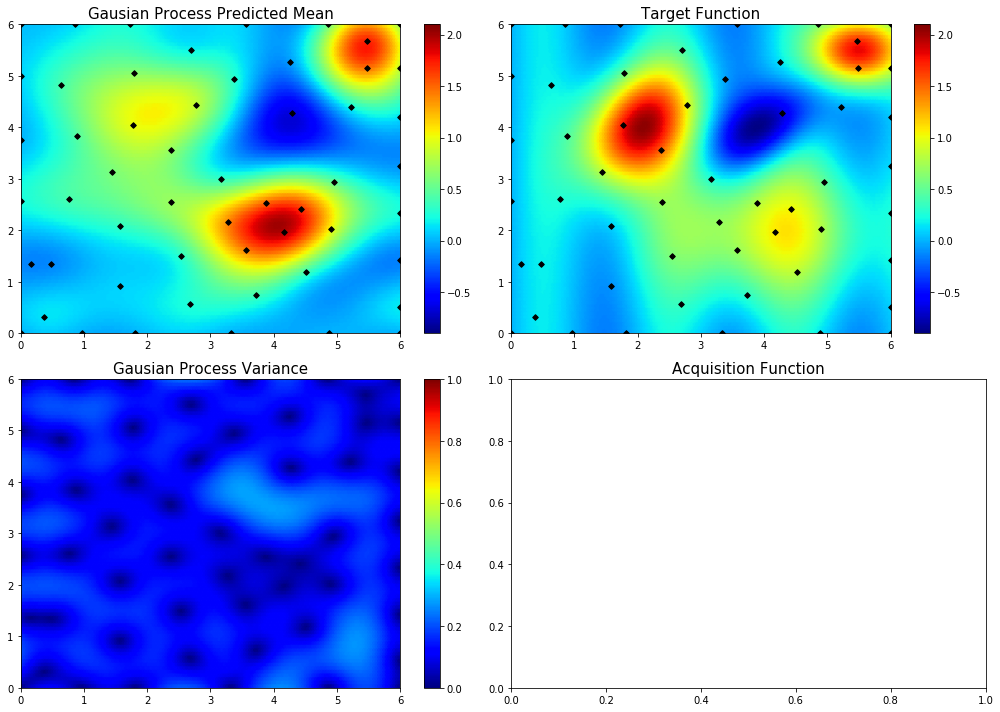

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
|  55       | -0.002237 |  3.227    |  4.153    |
myplot:  055


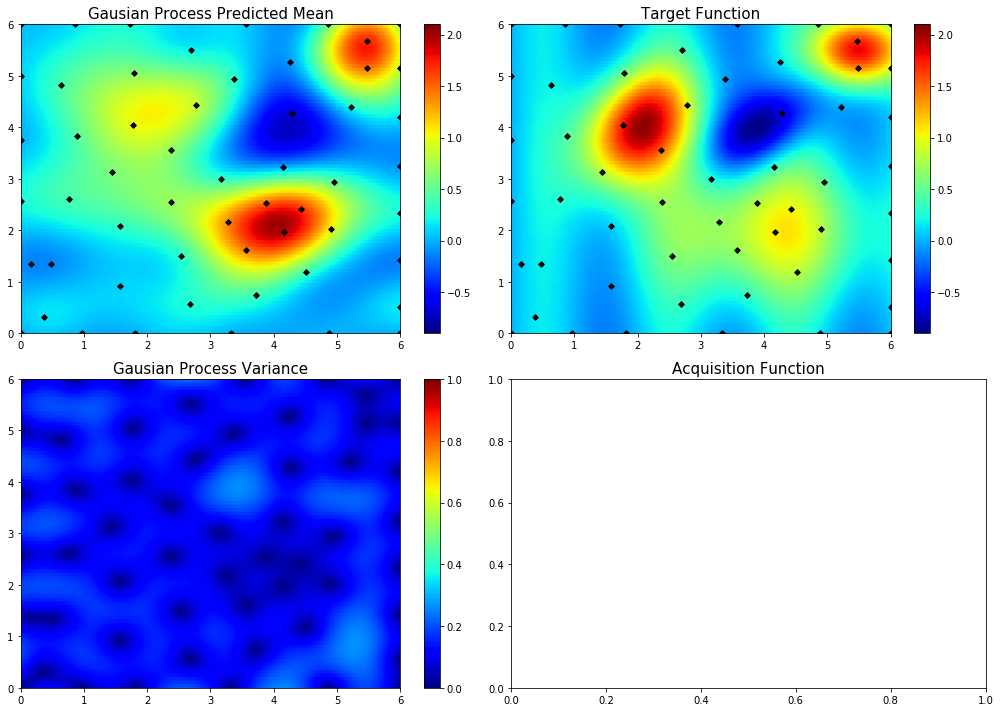

In [361]:

# Turn interactive plotting off
plt.ioff()

for i in range(50):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))